<a href="https://colab.research.google.com/github/ShinAsakawa/2019komazawa/blob/master/notebooks/2019komazawa_GAN_demo_Anime_Character.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preparing Inputs for the Network

We will need to download the data from a drive location so we import the following

---

- original: https://towardsdatascience.com/an-end-to-end-introduction-to-gans-bf253f1fa52f

In [1]:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth

from pydrive.drive import GoogleDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


     |████████████████████████████████| 993kB 47.8MB/s 


In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
download = drive.CreateFile({'id': '1i1M7GQZY5e8TYnFyD0ov-J7YjrI_YIGI'})
download.GetContentFile('data.zip')

In [4]:
!unzip data.zip # > /dev/null # Dont show any output

Archive:  data.zip
   creating: animeface-character-dataset/
   creating: animeface-character-dataset/tools/
  inflating: animeface-character-dataset/tools/tag_ja.txt  
   creating: __MACOSX/
   creating: __MACOSX/animeface-character-dataset/
   creating: __MACOSX/animeface-character-dataset/tools/
  inflating: __MACOSX/animeface-character-dataset/tools/._tag_ja.txt  
  inflating: animeface-character-dataset/tools/tag.txt  
  inflating: __MACOSX/animeface-character-dataset/tools/._tag.txt  
  inflating: animeface-character-dataset/tools/check.pl  
  inflating: __MACOSX/animeface-character-dataset/tools/._check.pl  
  inflating: animeface-character-dataset/tools/mkcolorcsv.pl  
  inflating: __MACOSX/animeface-character-dataset/tools/._mkcolorcsv.pl  
  inflating: animeface-character-dataset/tools/mktagjson.pl  
  inflating: __MACOSX/animeface-character-dataset/tools/._mktagjson.pl  
  inflating: animeface-character-dataset/tools/extanimeface.pl  
  inflating: __MACOSX/animeface-characte

In [5]:
!ls

adc.json  animeface-character-dataset  data.zip  __MACOSX  sample_data


Also the keras imports we have to do.

In [6]:
import os
import glob
os.environ["KERAS_BACKEND"] = "tensorflow"
import numpy as np
from sklearn.utils import shuffle
import time
import cv2
import scipy
from PIL import Image
import matplotlib.gridspec as gridspec
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers.core import Activation
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.core import Flatten
from keras.layers import Conv2D, Conv2DTranspose, Dropout
from keras.models import Model
from keras.optimizers import SGD, Adam, RMSprop
from keras.layers.advanced_activations import LeakyReLU
import matplotlib.pyplot as plt
from keras.models import load_model
from keras.utils.vis_utils import plot_model
import keras.backend as K
#from scipy.interpolate import spline
K.set_image_dim_ordering('tf')
import numpy as np
from sklearn.utils import shuffle
import tensorflow as tf
from keras.backend.tensorflow_backend import set_session
from keras.layers import Input, merge
from keras.initializers import RandomNormal
K.set_image_dim_ordering('tf')
config = tf.ConfigProto()
config.gpu_options.allow_growth = True 
set_session(tf.Session(config=config))
from collections import deque

Using TensorFlow backend.


# Visualize some images from the dataset

In [7]:
filenames = glob.glob('animeface-character-dataset/*/*/*.pn*')

print("Num_Images: ",len(filenames))

Num_Images:  14490


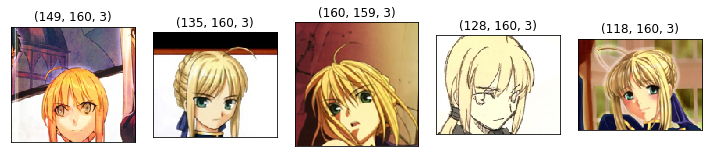

In [8]:
plt.figure(figsize=(10, 8))
for i in range(5):
    img = plt.imread(filenames[i], 0)
    plt.subplot(4, 5, i+1)
    plt.imshow(img)
    plt.title(img.shape)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

# Preprocessing the Images

Some helper preprocessing functions

In [0]:
# A function to normalize image pixels.
def norm_img(img):
    '''A function to Normalize Images.
    Input:
        img : Original image as numpy array.
    Output: Normailized Image as numpy array
    '''
    img = (img / 127.5) - 1
    return img

def denorm_img(img):
    '''A function to Denormailze, i.e. recreate image from normalized image
    Input:
        img : Normalized image as numpy array.
    Output: Original Image as numpy array
    '''
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 

def sample_from_dataset(batch_size, image_shape, data_dir=None):
    '''Create a batch of image samples by sampling random images from a data directory.
    Resizes the image using image_shape and normalize the images.
    Input:
        batch_size : Sample size required
        image_size : Size that Image should be resized to
        data_dir : Path of directory where training images are placed.

    Output:
        sample : batch of processed images 
    '''
    sample_dim = (batch_size,) + image_shape
    sample = np.empty(sample_dim, dtype=np.float32)
    all_data_dirlist = list(glob.glob(data_dir))
    sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)
    for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        image = image.convert('RGB') 
        image = np.asarray(image)
        image = norm_img(image)
        sample[index,...] = image
    return sample

# Keras Implementation of DCGAN

## 1. Generate Noise Vector for Generator

In [0]:
def gen_noise(batch_size, noise_shape):
    ''' Generates a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)
    Input:
        batch_size : size of batch
        noise_shape: shape of noise vector, normally kept as 100 
    Output:a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)     
    '''
    return np.random.normal(0, 1, size=(batch_size,)+noise_shape)

## 2. Generator Architecture

In [0]:
def get_gen_normal(noise_shape):
    ''' This function takes as input shape of the noise vector and creates the Keras generator    architecture.
    '''
    kernel_init = 'glorot_uniform'    
    gen_input = Input(shape = noise_shape) 
    
    # Transpose 2D conv layer 1. 
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 2.
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 3.
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 4.
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # conv 2D layer 1.
    generator = Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Final Transpose 2D conv layer 5 to generate final image. Filter size 3 for 3 image channel
    generator = Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    
    # Tanh activation to get final normalized image
    generator = Activation('tanh')(generator)
    
    # defining the optimizer and compiling the generator model.
    gen_opt = Adam(lr=0.00015, beta_1=0.5)
    generator_model = Model(input = gen_input, output = generator)
    generator_model.compile(loss='binary_crossentropy', optimizer=gen_opt, metrics=['accuracy'])
    generator_model.summary()
    return generator_model

## 3. Discriminator Architecture

In [0]:
def get_disc_normal(image_shape=(64,64,3)):
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)
    
    # Conv layer 1:
    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 2:
    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 3:   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 4:
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)#discriminator = MaxPooling2D(pool_size=(2, 2))(discriminator)
    # Flatten
    discriminator = Flatten()(discriminator)
    # Dense Layer
    discriminator = Dense(1)(discriminator)
    # Sigmoid Activation
    discriminator = Activation('sigmoid')(discriminator)
    # Optimizer and Compiling model
    dis_opt = Adam(lr=0.0002, beta_1=0.5)
    discriminator_model = Model(input = dis_input, output = discriminator)
    discriminator_model.compile(loss='binary_crossentropy', optimizer=dis_opt, metrics=['accuracy'])
    discriminator_model.summary()
    return discriminator_model

# Training and Saving Model

## 1. Specify Training parameters

Running for 2000 steps only to save time. You can run for more if needed

In [0]:
!mkdir images

In [14]:
!ls 

adc.json  animeface-character-dataset  data.zip  images  __MACOSX  sample_data


In [0]:
# Shape of noise vector to be input to the Generator
noise_shape = (1,1,100)
# Number of steps for training. num_epochs = num_steps*batch_size/data_size
num_steps = 2000
# batch size for training.
batch_size = 64
# Location to save images and logs 
img_save_dir = "images/"
# Image size to reshape to
image_shape = (64,64,3)
# Location of data directory
data_dir = "animeface-character-dataset/*/*/*.pn*"
# set up log and save directories
log_dir = img_save_dir
save_model_dir = img_save_dir

## 2. Helper Function 

In [0]:
def save_img_batch(img_batch,img_save_dir):
    '''Takes as input a image batch and a img_save_dir and saves 16 images from the batch in a 4x4 grid in the img_save_dir
    '''
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show() 

## 3. Create Discriminator and Generator

In [17]:
discriminator = get_disc_normal(image_shape)
generator = get_gen_normal(noise_shape)

W0620 01:18:09.375965 140262852286336 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0620 01:18:09.379959 140262852286336 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0620 01:18:09.392266 140262852286336 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0620 01:18:09.439143 140262852286336 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0620 01:18:09.440170 1402628522

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 256)         524544    
__________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


In [0]:
plot_model(generator, to_file='gen_plot.png', show_shapes=True, show_layer_names=True)

In [0]:
plot_model(discriminator, to_file='dis_plot.png', show_shapes=True, show_layer_names=True)

## 4. Combine Generator and Discriminator

In [20]:
discriminator.trainable = False

# Optimizer for the GAN
opt = Adam(lr=0.00015, beta_1=0.5) #same as generator
# Input to the generator
gen_inp = Input(shape=noise_shape)

GAN_inp = generator(gen_inp)
GAN_opt = discriminator(GAN_inp)

# Final GAN
gan = Model(input = gen_inp, output = GAN_opt)
gan.compile(loss = 'binary_crossentropy', optimizer = opt, metrics=['accuracy'])

plot_model(gan, to_file='gan_plot.png', show_shapes=True, show_layer_names=True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("mo...)`
  if sys.path[0] == '':


## 5. Assemble all blocks and train and save the model

Begin step:  0


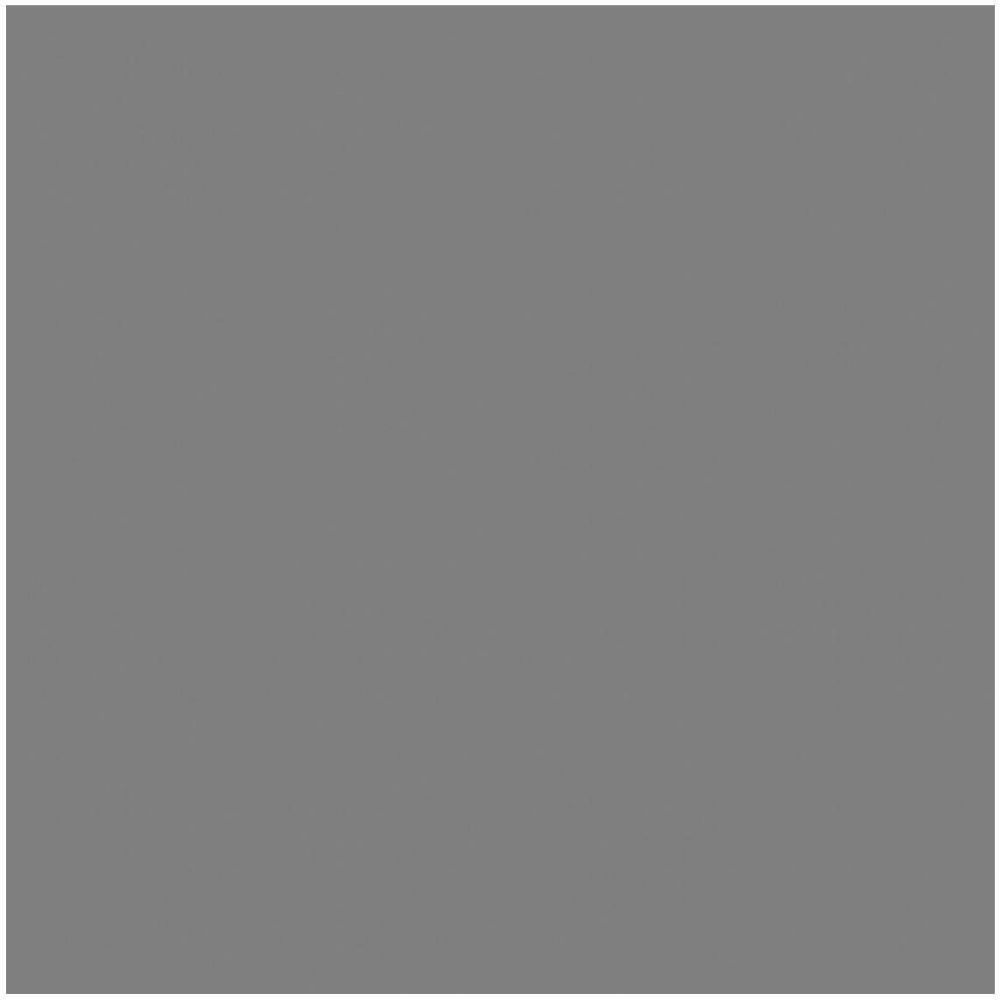

Disc: real loss: 0.560852 fake loss: 3.596640
GAN loss: 1.334742
Step 0 completed. Time took: 9 secs.
Begin step:  1
Disc: real loss: 0.690697 fake loss: 0.506732
GAN loss: 4.230948
Step 1 completed. Time took: 0 secs.
Begin step:  2
Disc: real loss: 0.555218 fake loss: 0.380605
GAN loss: 3.027062
Step 2 completed. Time took: 0 secs.
Begin step:  3
Disc: real loss: 0.528434 fake loss: 0.874455
GAN loss: 4.330040
Step 3 completed. Time took: 0 secs.
Begin step:  4
Disc: real loss: 0.456190 fake loss: 0.541908
GAN loss: 4.196508
Step 4 completed. Time took: 0 secs.
Begin step:  5
Disc: real loss: 0.497837 fake loss: 0.479563
GAN loss: 3.438197
Step 5 completed. Time took: 0 secs.
Begin step:  6
Disc: real loss: 0.515054 fake loss: 0.450962
GAN loss: 4.206284
Step 6 completed. Time took: 0 secs.
Begin step:  7
Disc: real loss: 0.542194 fake loss: 0.358673
GAN loss: 2.679018
Step 7 completed. Time took: 0 secs.
Begin step:  8
Disc: real loss: 0.491586 fake loss: 0.592691
GAN loss: 6.868029

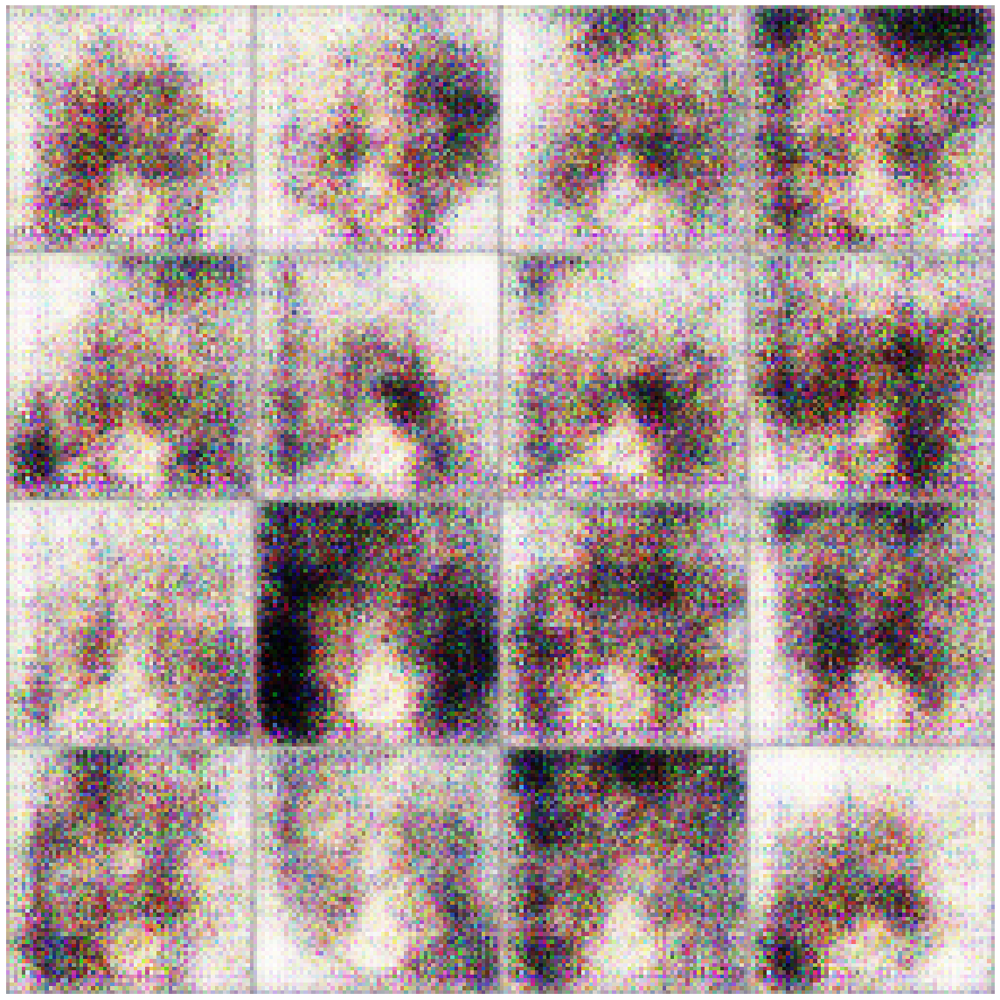

Disc: real loss: 0.672173 fake loss: 0.650554
GAN loss: 4.985300
Step 100 completed. Time took: 1 secs.
Begin step:  101
Disc: real loss: 0.580949 fake loss: 0.466971
GAN loss: 3.310496
Step 101 completed. Time took: 0 secs.
Begin step:  102
Disc: real loss: 0.386859 fake loss: 0.491454
GAN loss: 3.754107
Step 102 completed. Time took: 0 secs.
Begin step:  103
Disc: real loss: 0.437180 fake loss: 0.384353
GAN loss: 2.558815
Step 103 completed. Time took: 0 secs.
Begin step:  104
Disc: real loss: 0.358734 fake loss: 0.627235
GAN loss: 4.334969
Step 104 completed. Time took: 0 secs.
Begin step:  105
Disc: real loss: 0.822401 fake loss: 0.351546
GAN loss: 1.743696
Step 105 completed. Time took: 0 secs.
Begin step:  106
Disc: real loss: 0.471091 fake loss: 0.694717
GAN loss: 4.447208
Step 106 completed. Time took: 0 secs.
Begin step:  107
Disc: real loss: 0.697023 fake loss: 0.372038
GAN loss: 1.744296
Step 107 completed. Time took: 0 secs.
Begin step:  108
Disc: real loss: 0.409091 fake l

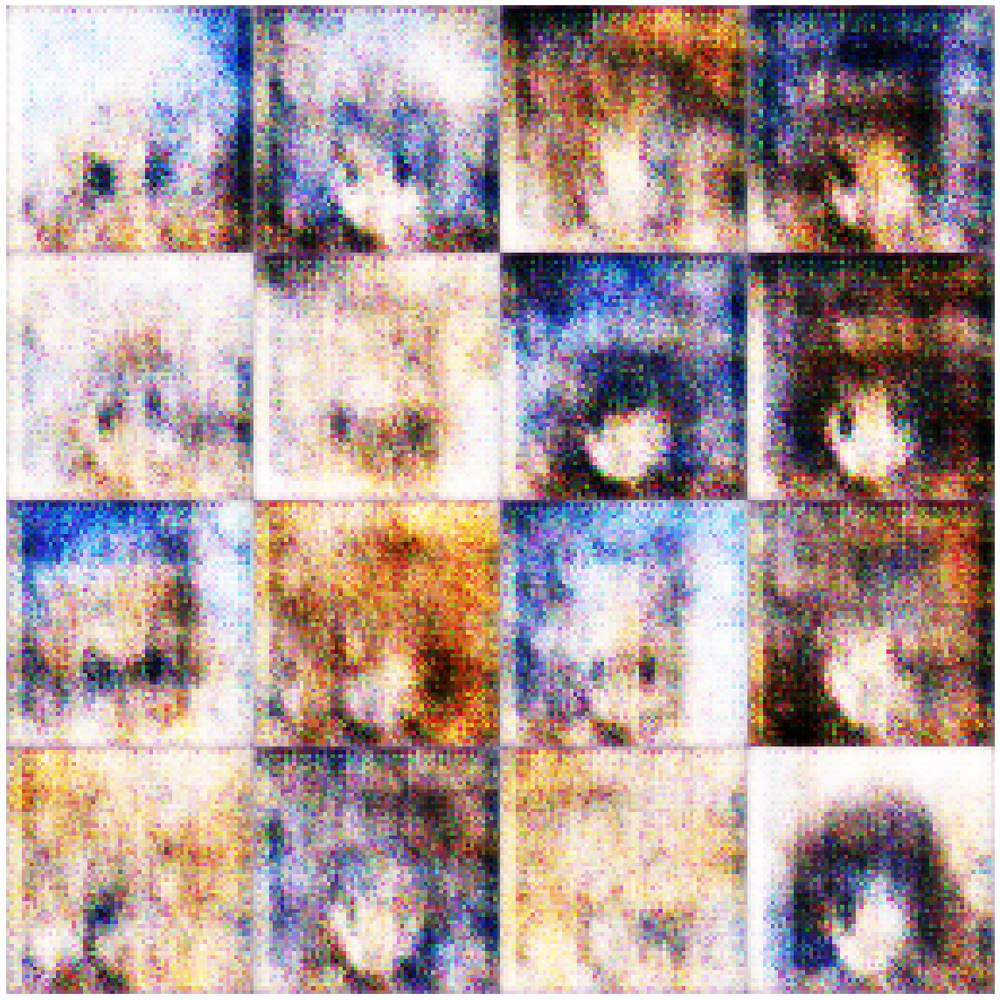

Disc: real loss: 0.442772 fake loss: 0.373330
GAN loss: 2.654652
Step 200 completed. Time took: 1 secs.
Begin step:  201
Disc: real loss: 0.499546 fake loss: 1.063158
GAN loss: 4.609597
Step 201 completed. Time took: 0 secs.
Begin step:  202
Disc: real loss: 1.129876 fake loss: 0.363289
GAN loss: 2.105191
Step 202 completed. Time took: 0 secs.
Begin step:  203
Disc: real loss: 0.388992 fake loss: 0.605495
GAN loss: 2.836975
Step 203 completed. Time took: 0 secs.
Begin step:  204
Disc: real loss: 0.437131 fake loss: 0.371798
GAN loss: 2.316013
Step 204 completed. Time took: 0 secs.
Begin step:  205
Disc: real loss: 0.415880 fake loss: 0.406157
GAN loss: 1.918173
Step 205 completed. Time took: 0 secs.
Begin step:  206
Disc: real loss: 0.396522 fake loss: 0.450874
GAN loss: 2.205220
Step 206 completed. Time took: 0 secs.
Begin step:  207
Disc: real loss: 0.572995 fake loss: 0.448200
GAN loss: 1.755453
Step 207 completed. Time took: 0 secs.
Begin step:  208
Disc: real loss: 0.410563 fake l

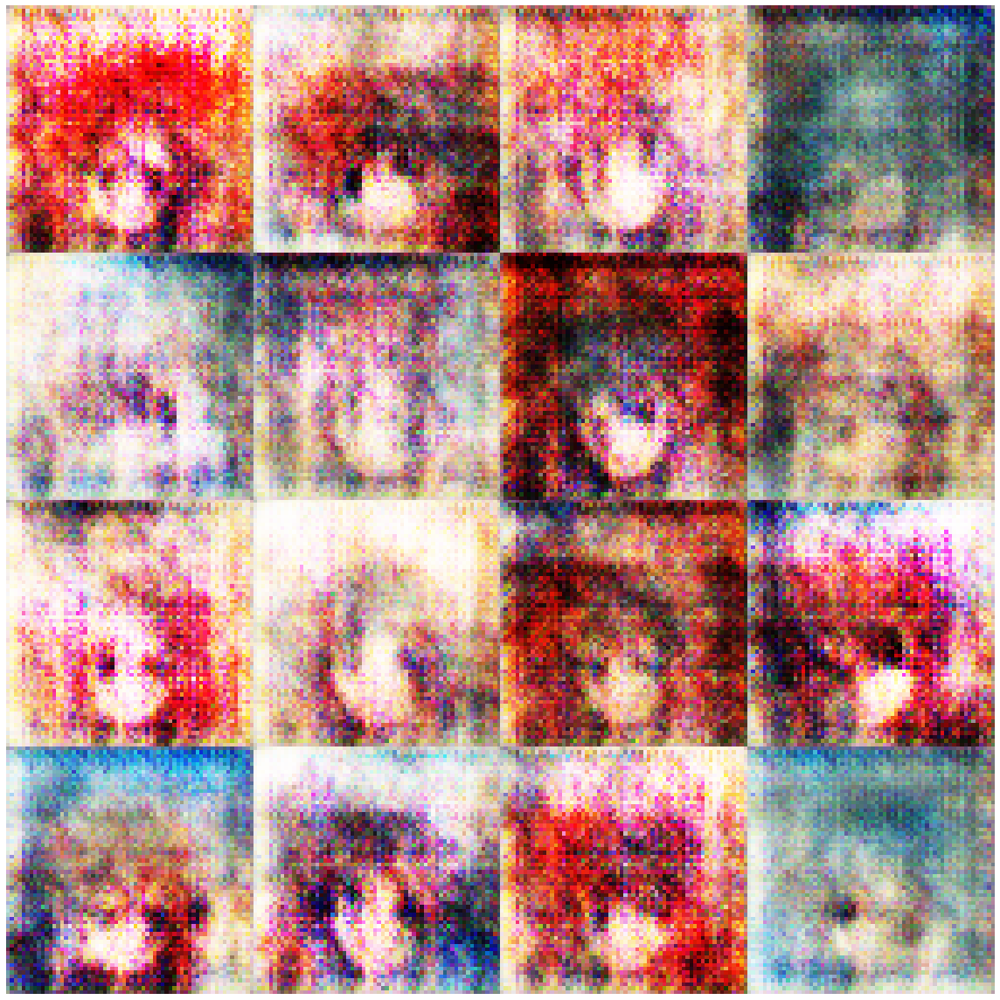

Disc: real loss: 0.827112 fake loss: 0.382079
GAN loss: 1.803746
Step 300 completed. Time took: 1 secs.
Begin step:  301
Disc: real loss: 0.421125 fake loss: 0.727744
GAN loss: 3.336267
Step 301 completed. Time took: 0 secs.
Begin step:  302
Disc: real loss: 0.548968 fake loss: 0.396127
GAN loss: 2.355972
Step 302 completed. Time took: 0 secs.
Begin step:  303
Disc: real loss: 0.420110 fake loss: 0.897895
GAN loss: 4.316640
Step 303 completed. Time took: 0 secs.
Begin step:  304
Disc: real loss: 0.831744 fake loss: 0.383714
GAN loss: 2.229855
Step 304 completed. Time took: 0 secs.
Begin step:  305
Disc: real loss: 0.379773 fake loss: 0.467921
GAN loss: 1.815645
Step 305 completed. Time took: 0 secs.
Begin step:  306
Disc: real loss: 0.365291 fake loss: 0.371753
GAN loss: 2.161762
Step 306 completed. Time took: 0 secs.
Begin step:  307
Disc: real loss: 0.477605 fake loss: 0.510944
GAN loss: 2.235473
Step 307 completed. Time took: 0 secs.
Begin step:  308
Disc: real loss: 0.499845 fake l

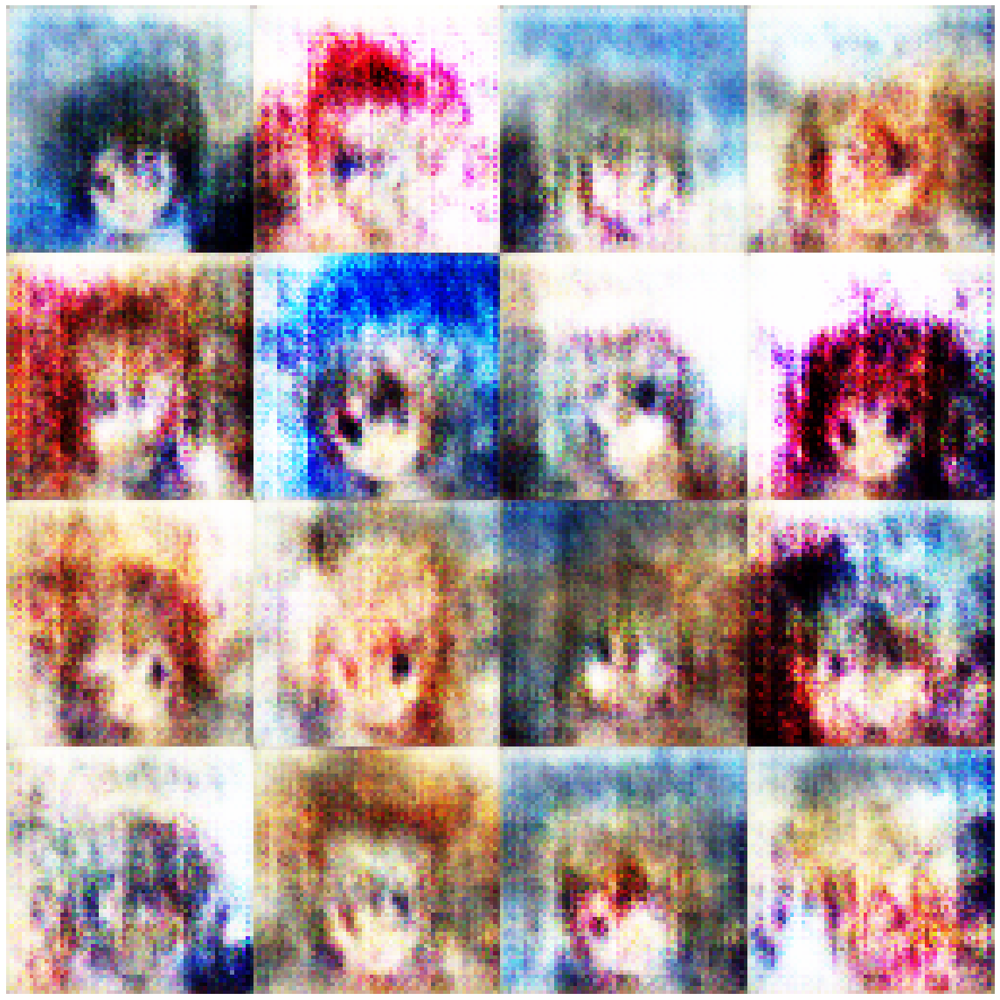

Disc: real loss: 0.451927 fake loss: 0.497088
GAN loss: 2.549142
Step 400 completed. Time took: 1 secs.
Begin step:  401
Disc: real loss: 0.386588 fake loss: 0.335220
GAN loss: 2.246336
Step 401 completed. Time took: 0 secs.
Begin step:  402
Disc: real loss: 0.382466 fake loss: 0.365977
GAN loss: 2.160062
Step 402 completed. Time took: 0 secs.
Begin step:  403
Disc: real loss: 0.403027 fake loss: 0.406331
GAN loss: 2.827615
Step 403 completed. Time took: 0 secs.
Begin step:  404
Disc: real loss: 0.489786 fake loss: 0.359388
GAN loss: 2.356295
Step 404 completed. Time took: 0 secs.
Begin step:  405
Disc: real loss: 0.597125 fake loss: 0.928858
GAN loss: 3.890968
Step 405 completed. Time took: 0 secs.
Begin step:  406
Disc: real loss: 0.738115 fake loss: 0.359878
GAN loss: 2.709194
Step 406 completed. Time took: 0 secs.
Begin step:  407
Disc: real loss: 0.393238 fake loss: 0.512380
GAN loss: 3.082119
Step 407 completed. Time took: 0 secs.
Begin step:  408
Disc: real loss: 0.349217 fake l

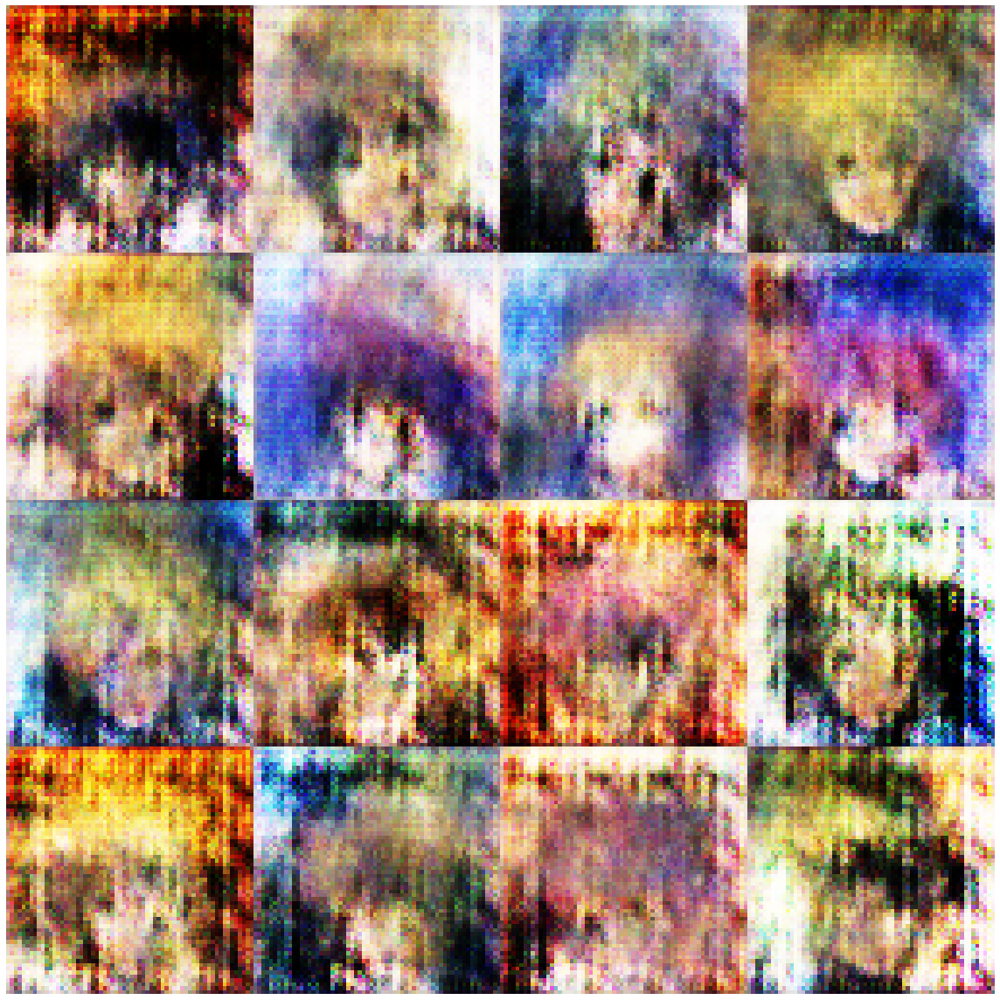

Begin step:  500


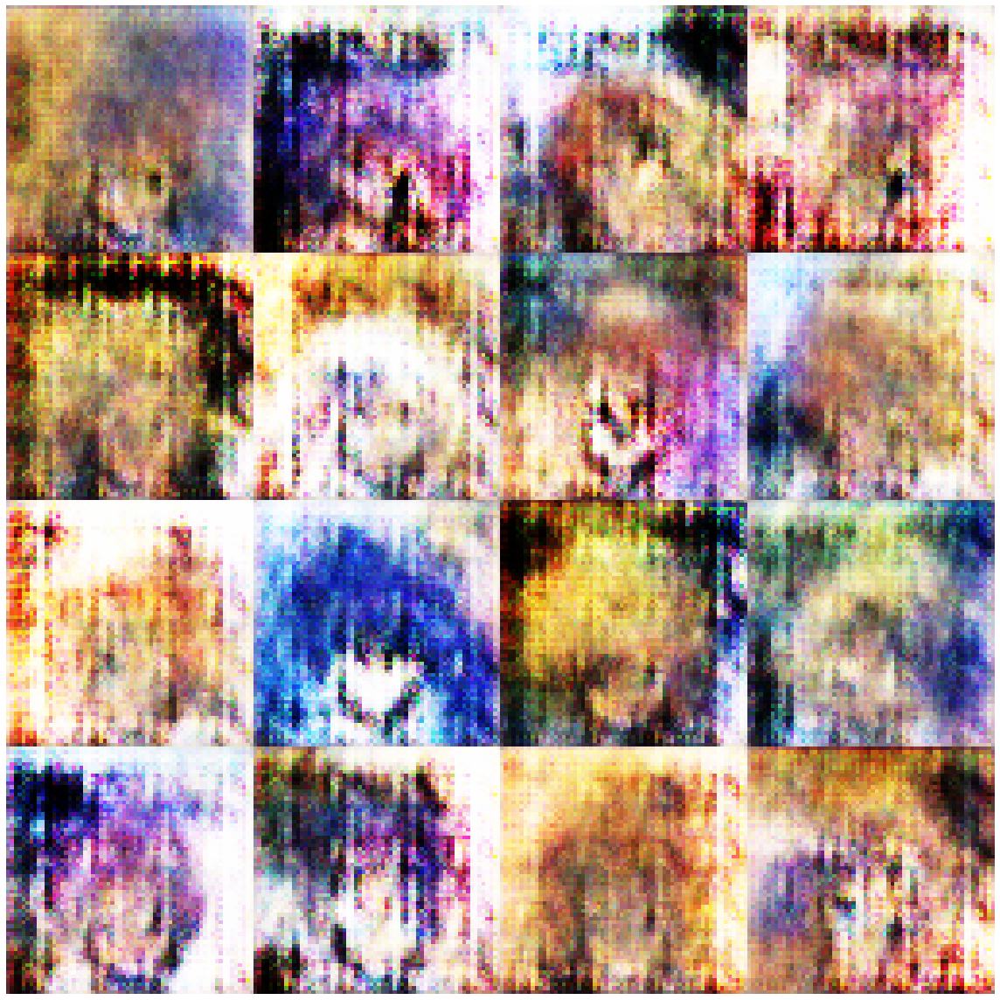

Disc: real loss: 0.569351 fake loss: 0.391466
GAN loss: 2.245890
Step 500 completed. Time took: 1 secs.
Begin step:  501
Disc: real loss: 0.385568 fake loss: 0.561667
GAN loss: 2.946275
Step 501 completed. Time took: 0 secs.
Begin step:  502
Disc: real loss: 0.450299 fake loss: 0.401458
GAN loss: 2.930242
Step 502 completed. Time took: 0 secs.
Begin step:  503
Disc: real loss: 0.600623 fake loss: 0.621359
GAN loss: 3.051825
Step 503 completed. Time took: 0 secs.
Begin step:  504
Disc: real loss: 0.541280 fake loss: 0.411643
GAN loss: 2.655768
Step 504 completed. Time took: 0 secs.
Begin step:  505
Disc: real loss: 0.540475 fake loss: 0.590372
GAN loss: 3.055446
Step 505 completed. Time took: 0 secs.
Begin step:  506
Disc: real loss: 0.504816 fake loss: 0.358380
GAN loss: 2.054959
Step 506 completed. Time took: 0 secs.
Begin step:  507
Disc: real loss: 0.388448 fake loss: 0.678834
GAN loss: 3.832173
Step 507 completed. Time took: 0 secs.
Begin step:  508
Disc: real loss: 0.630573 fake l

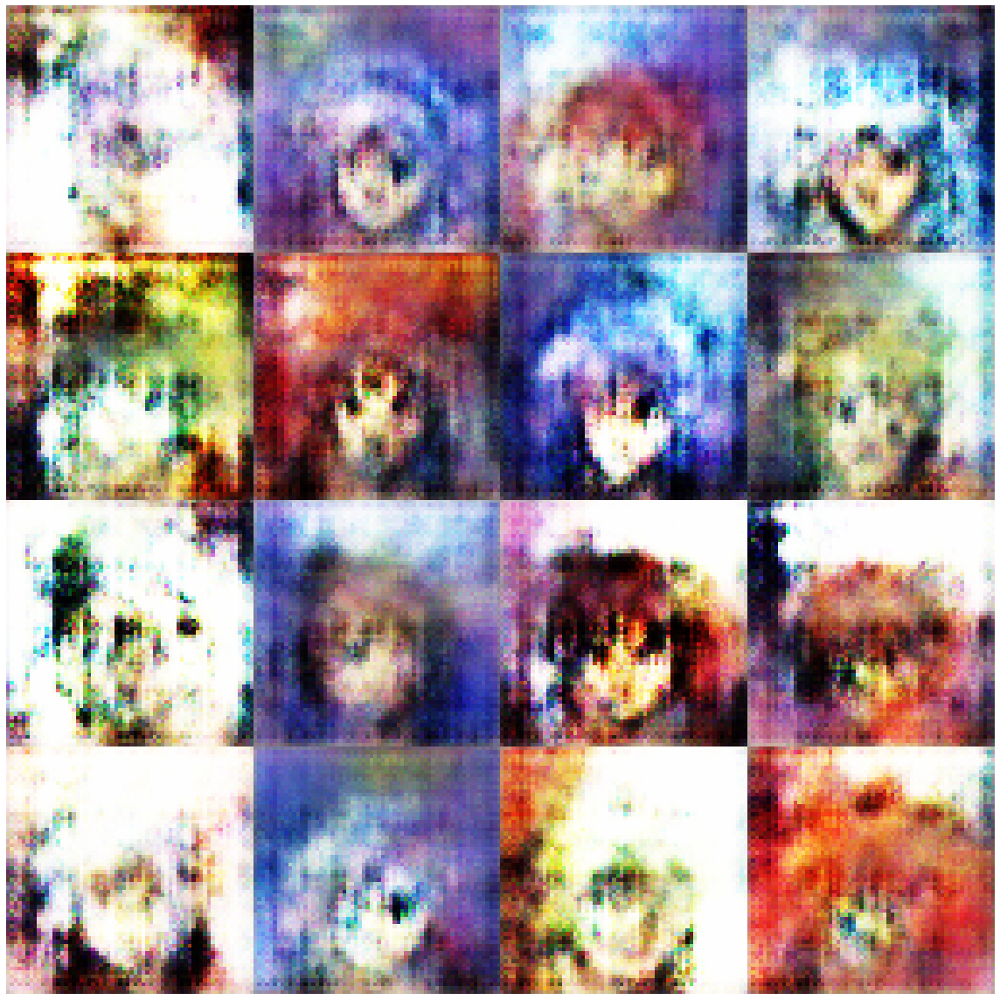

Disc: real loss: 0.518842 fake loss: 0.505302
GAN loss: 2.156041
Step 600 completed. Time took: 1 secs.
Begin step:  601
Disc: real loss: 0.454478 fake loss: 0.394648
GAN loss: 2.463706
Step 601 completed. Time took: 0 secs.
Begin step:  602
Disc: real loss: 0.519302 fake loss: 0.523839
GAN loss: 2.767562
Step 602 completed. Time took: 0 secs.
Begin step:  603
Disc: real loss: 0.521718 fake loss: 0.427216
GAN loss: 2.103236
Step 603 completed. Time took: 0 secs.
Begin step:  604
Disc: real loss: 0.429631 fake loss: 0.412519
GAN loss: 2.255232
Step 604 completed. Time took: 0 secs.
Begin step:  605
Disc: real loss: 0.456906 fake loss: 0.493650
GAN loss: 2.269613
Step 605 completed. Time took: 0 secs.
Begin step:  606
Disc: real loss: 0.534399 fake loss: 0.432185
GAN loss: 2.273760
Step 606 completed. Time took: 0 secs.
Begin step:  607
Disc: real loss: 0.567013 fake loss: 0.525072
GAN loss: 2.301259
Step 607 completed. Time took: 0 secs.
Begin step:  608
Disc: real loss: 0.438386 fake l

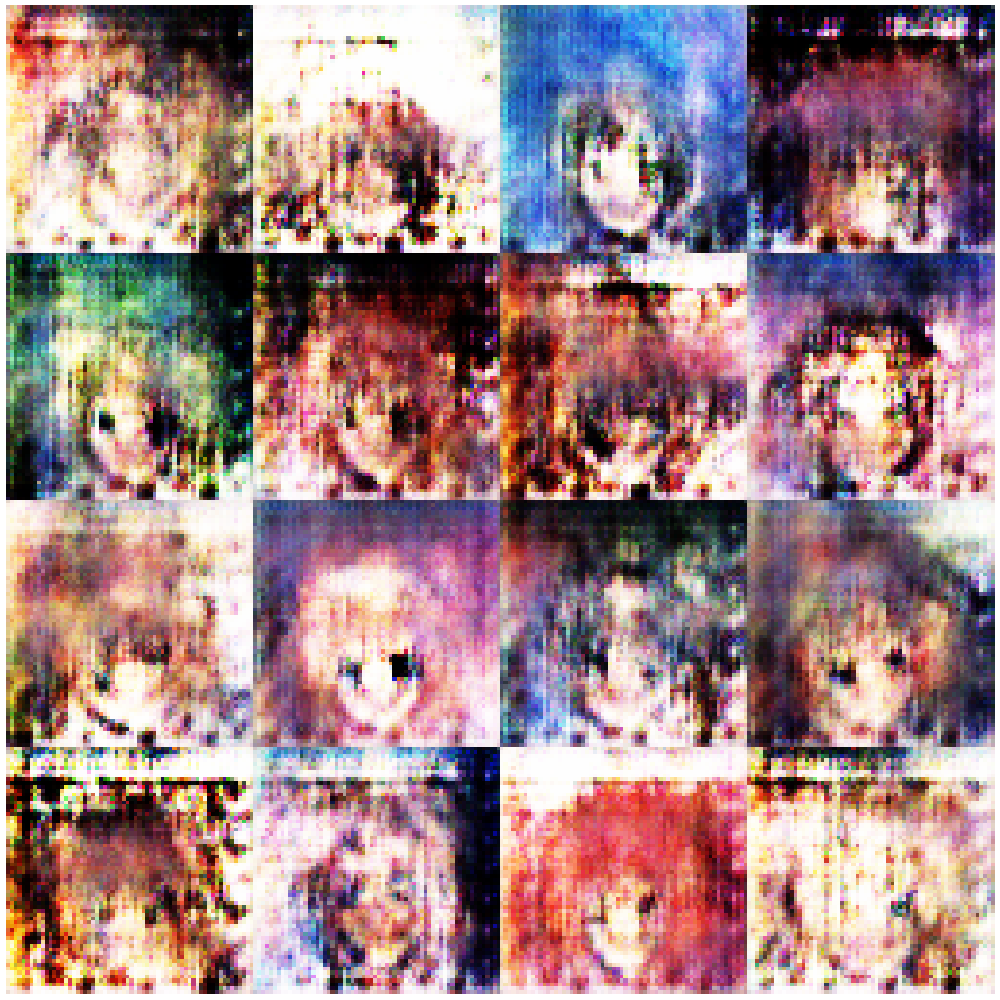

Disc: real loss: 0.386217 fake loss: 0.865491
GAN loss: 4.008577
Step 700 completed. Time took: 1 secs.
Begin step:  701
Disc: real loss: 0.765241 fake loss: 0.363199
GAN loss: 1.808259
Step 701 completed. Time took: 0 secs.
Begin step:  702
Disc: real loss: 0.374896 fake loss: 0.722535
GAN loss: 3.349590
Step 702 completed. Time took: 0 secs.
Begin step:  703
Disc: real loss: 0.649535 fake loss: 0.343242
GAN loss: 2.004158
Step 703 completed. Time took: 0 secs.
Begin step:  704
Disc: real loss: 0.386636 fake loss: 0.596604
GAN loss: 3.251001
Step 704 completed. Time took: 0 secs.
Begin step:  705
Disc: real loss: 0.473632 fake loss: 0.346440
GAN loss: 2.321004
Step 705 completed. Time took: 0 secs.
Begin step:  706
Disc: real loss: 0.433907 fake loss: 0.474550
GAN loss: 2.588936
Step 706 completed. Time took: 0 secs.
Begin step:  707
Disc: real loss: 0.453810 fake loss: 0.407088
GAN loss: 2.127408
Step 707 completed. Time took: 0 secs.
Begin step:  708
Disc: real loss: 0.369451 fake l

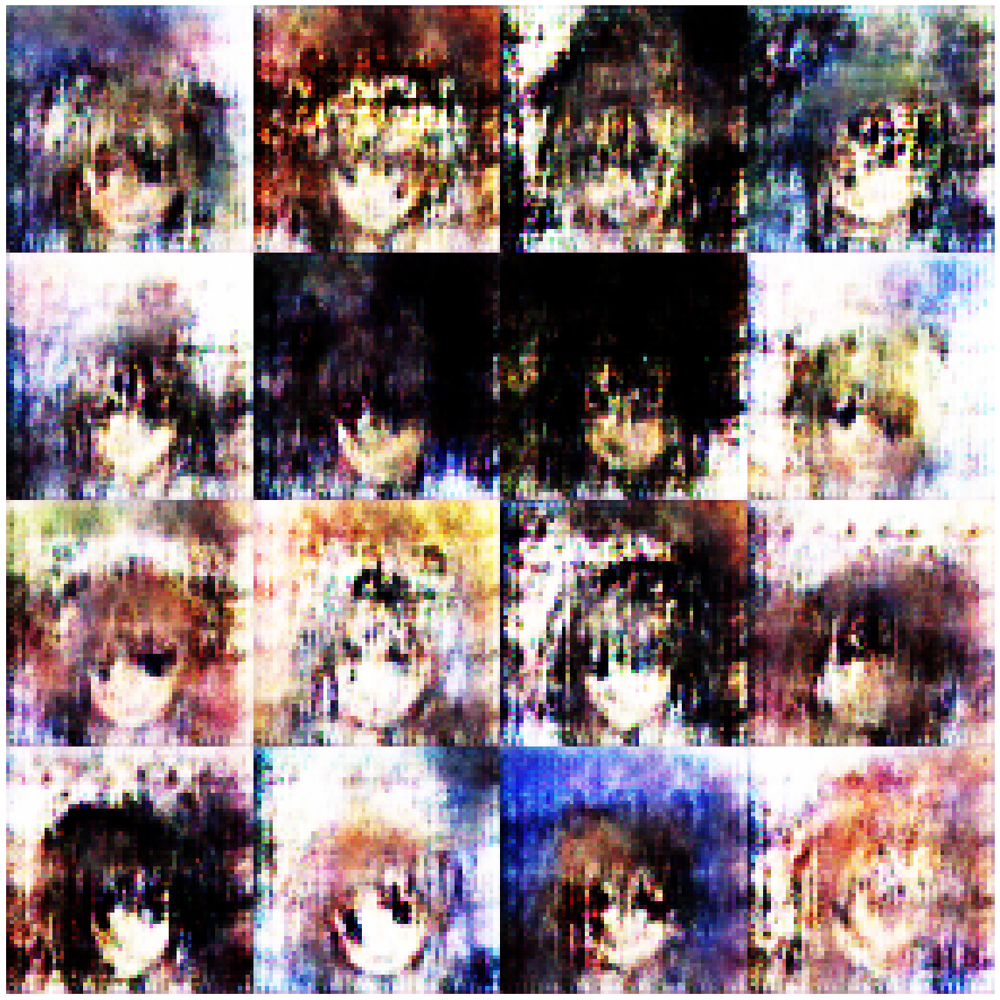

Disc: real loss: 0.553013 fake loss: 0.650224
GAN loss: 3.755536
Step 800 completed. Time took: 1 secs.
Begin step:  801
Disc: real loss: 0.685532 fake loss: 0.397334
GAN loss: 2.191527
Step 801 completed. Time took: 0 secs.
Begin step:  802
Disc: real loss: 0.357042 fake loss: 0.634923
GAN loss: 3.996408
Step 802 completed. Time took: 0 secs.
Begin step:  803
Disc: real loss: 0.634434 fake loss: 0.444057
GAN loss: 2.514722
Step 803 completed. Time took: 0 secs.
Begin step:  804
Disc: real loss: 0.410298 fake loss: 0.425576
GAN loss: 3.553291
Step 804 completed. Time took: 0 secs.
Begin step:  805
Disc: real loss: 0.482299 fake loss: 0.387052
GAN loss: 2.445207
Step 805 completed. Time took: 0 secs.
Begin step:  806
Disc: real loss: 0.475615 fake loss: 0.812719
GAN loss: 3.761334
Step 806 completed. Time took: 0 secs.
Begin step:  807
Disc: real loss: 0.618809 fake loss: 0.567626
GAN loss: 4.118220
Step 807 completed. Time took: 0 secs.
Begin step:  808
Disc: real loss: 0.639861 fake l

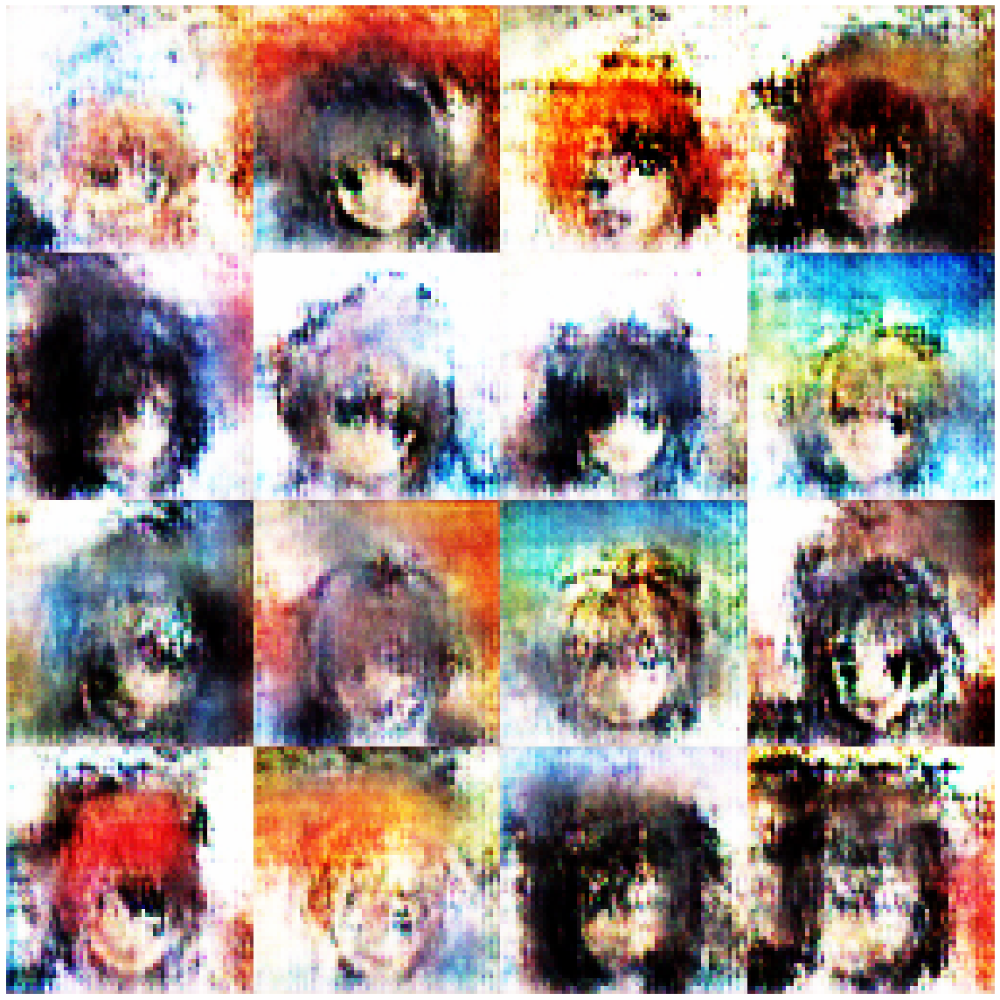

Disc: real loss: 0.486149 fake loss: 0.757618
GAN loss: 3.040258
Step 900 completed. Time took: 1 secs.
Begin step:  901
Disc: real loss: 0.662776 fake loss: 0.393297
GAN loss: 2.306421
Step 901 completed. Time took: 0 secs.
Begin step:  902
Disc: real loss: 0.400008 fake loss: 0.711816
GAN loss: 3.305694
Step 902 completed. Time took: 0 secs.
Begin step:  903
Disc: real loss: 0.589253 fake loss: 0.348432
GAN loss: 1.921876
Step 903 completed. Time took: 0 secs.
Begin step:  904
Disc: real loss: 0.405057 fake loss: 0.666325
GAN loss: 3.549430
Step 904 completed. Time took: 0 secs.
Begin step:  905
Disc: real loss: 0.650157 fake loss: 0.358664
GAN loss: 1.811927
Step 905 completed. Time took: 0 secs.
Begin step:  906
Disc: real loss: 0.407757 fake loss: 0.562263
GAN loss: 3.281364
Step 906 completed. Time took: 0 secs.
Begin step:  907
Disc: real loss: 0.554474 fake loss: 0.348501
GAN loss: 2.282431
Step 907 completed. Time took: 0 secs.
Begin step:  908
Disc: real loss: 0.386228 fake l

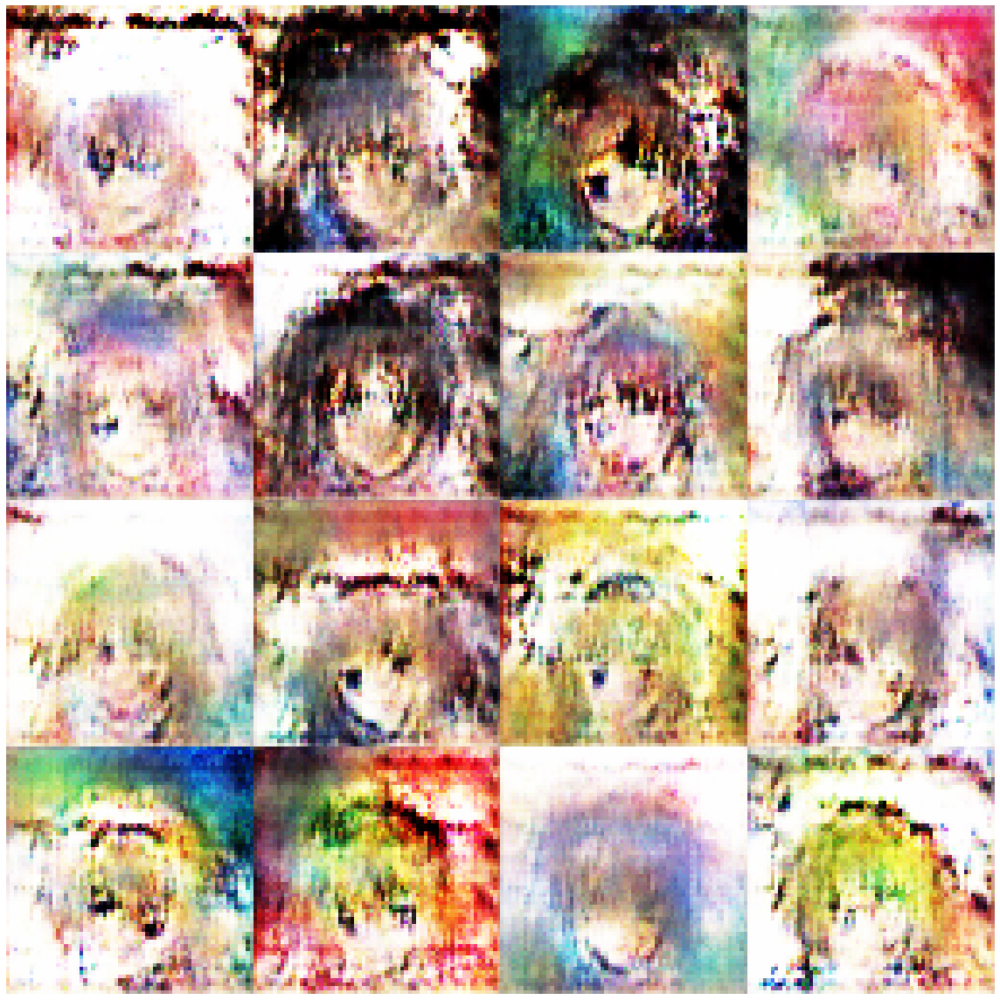

Begin step:  1000


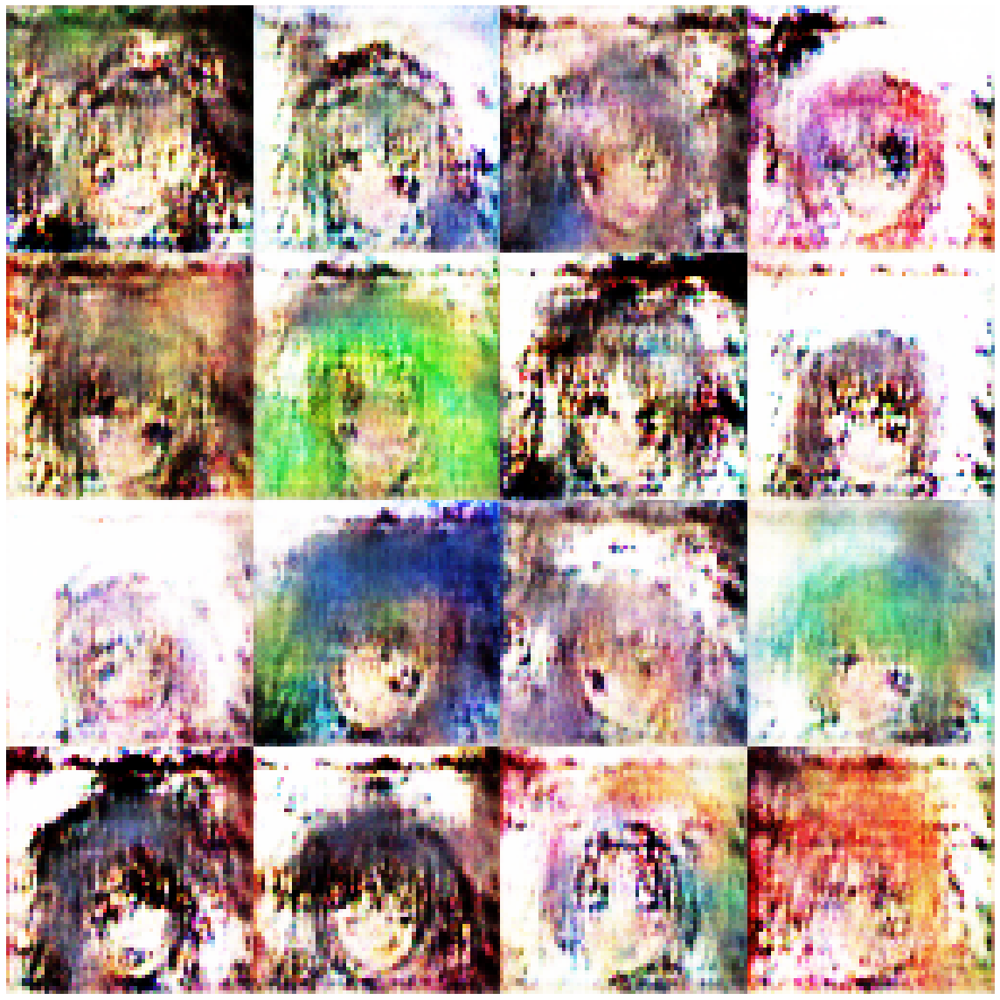

Disc: real loss: 0.453523 fake loss: 0.459217
GAN loss: 2.737182
Step 1000 completed. Time took: 1 secs.
Begin step:  1001
Disc: real loss: 0.426556 fake loss: 0.446704
GAN loss: 2.980628
Step 1001 completed. Time took: 0 secs.
Begin step:  1002
Disc: real loss: 0.487170 fake loss: 0.347155
GAN loss: 2.321323
Step 1002 completed. Time took: 0 secs.
Begin step:  1003
Disc: real loss: 0.372373 fake loss: 0.436848
GAN loss: 3.305130
Step 1003 completed. Time took: 0 secs.
Begin step:  1004
Disc: real loss: 0.467508 fake loss: 0.390198
GAN loss: 2.532545
Step 1004 completed. Time took: 0 secs.
Begin step:  1005
Disc: real loss: 0.412594 fake loss: 0.377012
GAN loss: 2.157011
Step 1005 completed. Time took: 0 secs.
Begin step:  1006
Disc: real loss: 0.373967 fake loss: 0.385086
GAN loss: 2.653697
Step 1006 completed. Time took: 0 secs.
Begin step:  1007
Disc: real loss: 0.538559 fake loss: 0.460928
GAN loss: 3.225235
Step 1007 completed. Time took: 0 secs.
Begin step:  1008
Disc: real loss:

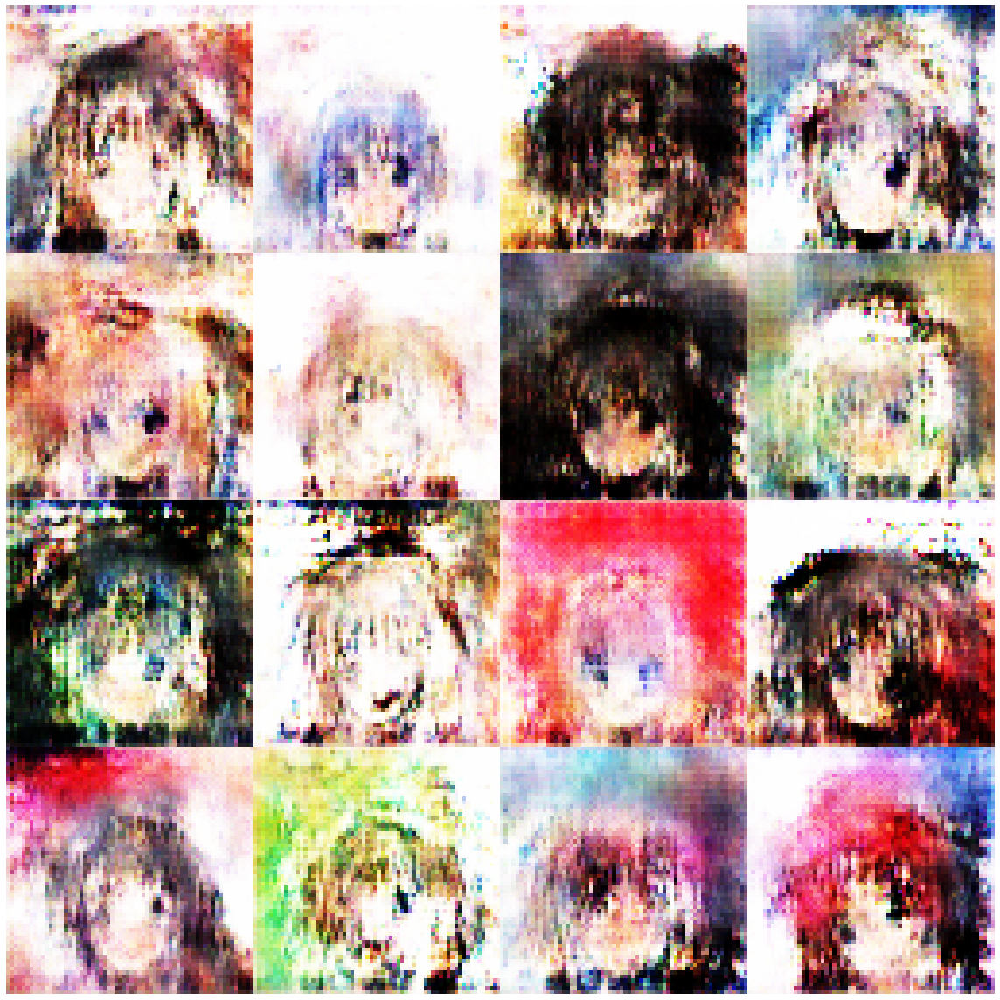

Disc: real loss: 0.437449 fake loss: 0.417095
GAN loss: 2.083293
Step 1100 completed. Time took: 1 secs.
Begin step:  1101
Disc: real loss: 0.390225 fake loss: 0.403739
GAN loss: 2.540534
Step 1101 completed. Time took: 0 secs.
Begin step:  1102
Disc: real loss: 0.508996 fake loss: 0.440033
GAN loss: 2.404142
Step 1102 completed. Time took: 0 secs.
Begin step:  1103
Disc: real loss: 0.489693 fake loss: 0.468078
GAN loss: 2.592889
Step 1103 completed. Time took: 0 secs.
Begin step:  1104
Disc: real loss: 0.431073 fake loss: 0.356306
GAN loss: 2.592529
Step 1104 completed. Time took: 0 secs.
Begin step:  1105
Disc: real loss: 0.370562 fake loss: 0.434053
GAN loss: 2.487043
Step 1105 completed. Time took: 0 secs.
Begin step:  1106
Disc: real loss: 0.484050 fake loss: 0.460570
GAN loss: 2.907328
Step 1106 completed. Time took: 0 secs.
Begin step:  1107
Disc: real loss: 0.499953 fake loss: 0.330659
GAN loss: 2.177124
Step 1107 completed. Time took: 0 secs.
Begin step:  1108
Disc: real loss:

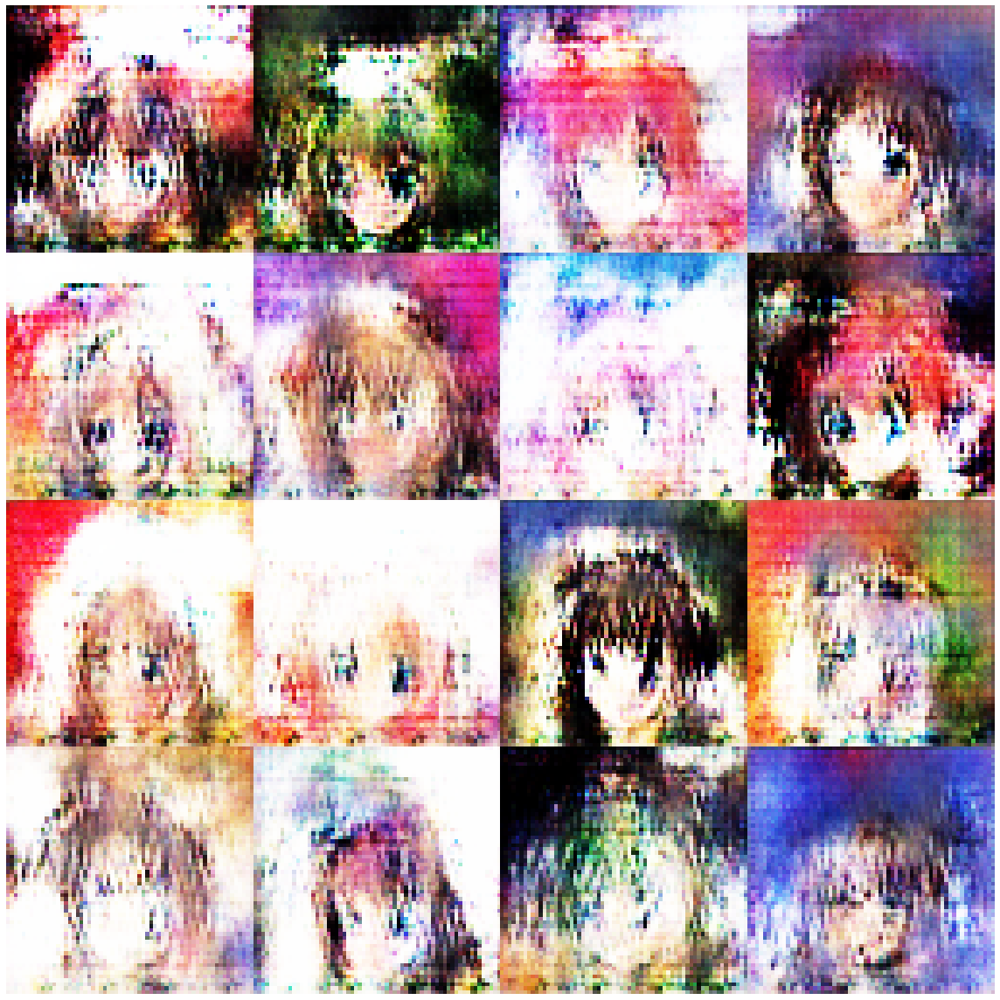

Disc: real loss: 0.357006 fake loss: 0.392213
GAN loss: 2.466885
Step 1200 completed. Time took: 1 secs.
Begin step:  1201
Disc: real loss: 0.410064 fake loss: 0.516911
GAN loss: 3.456606
Step 1201 completed. Time took: 0 secs.
Begin step:  1202
Disc: real loss: 0.552555 fake loss: 0.352299
GAN loss: 2.530746
Step 1202 completed. Time took: 0 secs.
Begin step:  1203
Disc: real loss: 0.339811 fake loss: 0.527656
GAN loss: 3.511028
Step 1203 completed. Time took: 0 secs.
Begin step:  1204
Disc: real loss: 0.362966 fake loss: 0.377944
GAN loss: 2.781608
Step 1204 completed. Time took: 0 secs.
Begin step:  1205
Disc: real loss: 0.377997 fake loss: 0.413365
GAN loss: 2.466438
Step 1205 completed. Time took: 0 secs.
Begin step:  1206
Disc: real loss: 0.408291 fake loss: 0.502377
GAN loss: 3.253148
Step 1206 completed. Time took: 0 secs.
Begin step:  1207
Disc: real loss: 0.570122 fake loss: 0.383870
GAN loss: 2.285429
Step 1207 completed. Time took: 0 secs.
Begin step:  1208
Disc: real loss:

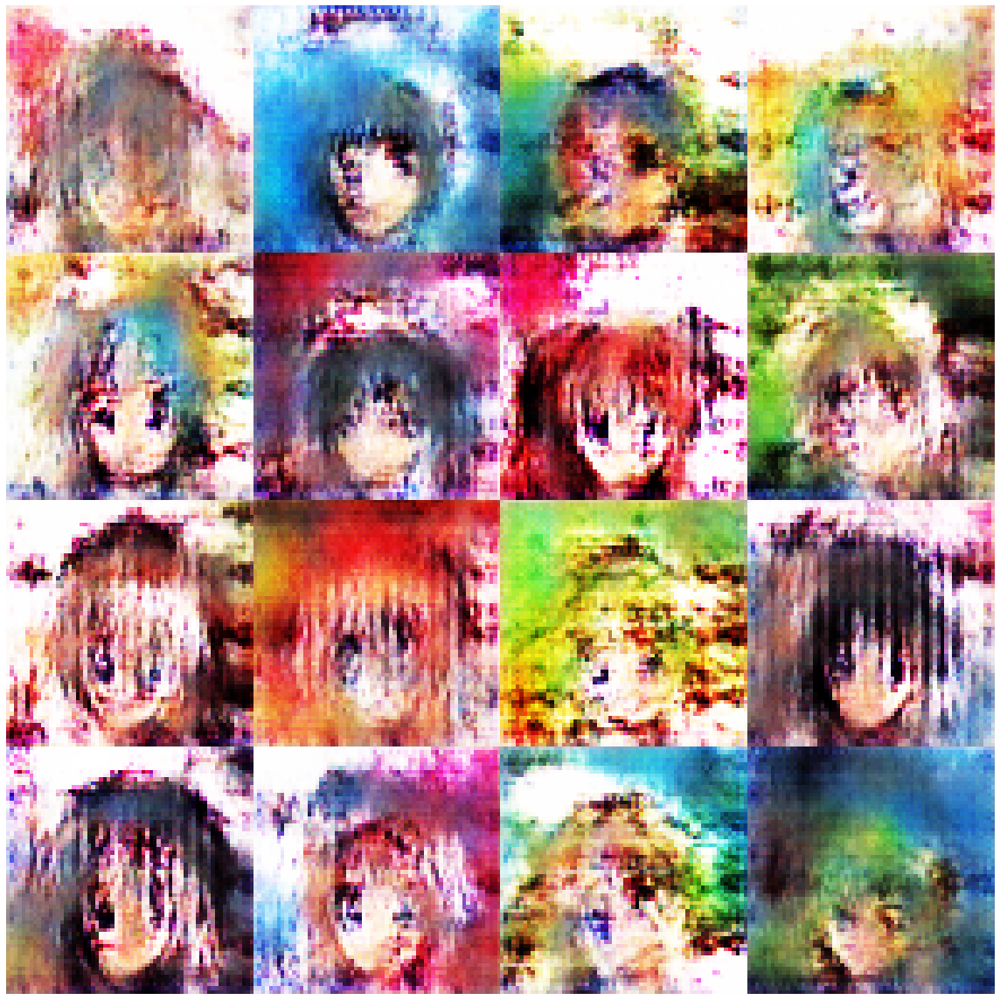

Disc: real loss: 0.370462 fake loss: 0.352717
GAN loss: 2.619972
Step 1300 completed. Time took: 1 secs.
Begin step:  1301
Disc: real loss: 0.386502 fake loss: 0.509609
GAN loss: 3.287942
Step 1301 completed. Time took: 0 secs.
Begin step:  1302
Disc: real loss: 0.582070 fake loss: 0.357405
GAN loss: 2.252336
Step 1302 completed. Time took: 0 secs.
Begin step:  1303
Disc: real loss: 0.357484 fake loss: 0.417786
GAN loss: 2.716274
Step 1303 completed. Time took: 0 secs.
Begin step:  1304
Disc: real loss: 0.424054 fake loss: 0.378285
GAN loss: 2.435157
Step 1304 completed. Time took: 0 secs.
Begin step:  1305
Disc: real loss: 0.354310 fake loss: 0.355189
GAN loss: 3.104720
Step 1305 completed. Time took: 0 secs.
Begin step:  1306
Disc: real loss: 0.444950 fake loss: 0.491748
GAN loss: 3.636345
Step 1306 completed. Time took: 0 secs.
Begin step:  1307
Disc: real loss: 0.444642 fake loss: 0.348286
GAN loss: 2.099230
Step 1307 completed. Time took: 0 secs.
Begin step:  1308
Disc: real loss:

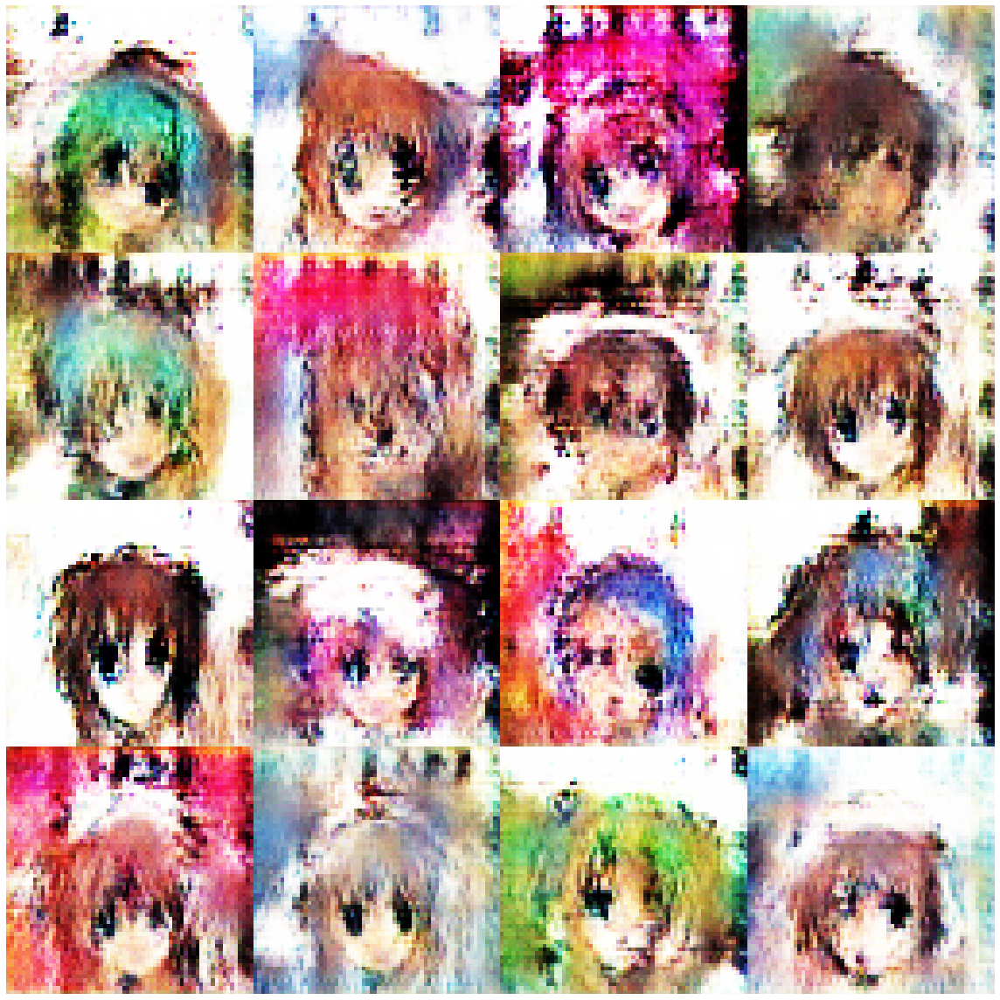

Disc: real loss: 0.383185 fake loss: 0.422117
GAN loss: 3.232571
Step 1400 completed. Time took: 1 secs.
Begin step:  1401
Disc: real loss: 0.403793 fake loss: 0.342072
GAN loss: 2.464963
Step 1401 completed. Time took: 0 secs.
Begin step:  1402
Disc: real loss: 0.357681 fake loss: 0.422869
GAN loss: 3.325884
Step 1402 completed. Time took: 0 secs.
Begin step:  1403
Disc: real loss: 0.426746 fake loss: 0.380240
GAN loss: 2.234745
Step 1403 completed. Time took: 0 secs.
Begin step:  1404
Disc: real loss: 0.381673 fake loss: 0.528651
GAN loss: 3.685097
Step 1404 completed. Time took: 0 secs.
Begin step:  1405
Disc: real loss: 0.646554 fake loss: 0.368361
GAN loss: 1.988975
Step 1405 completed. Time took: 0 secs.
Begin step:  1406
Disc: real loss: 0.340172 fake loss: 0.361757
GAN loss: 2.281622
Step 1406 completed. Time took: 0 secs.
Begin step:  1407
Disc: real loss: 0.406078 fake loss: 0.394228
GAN loss: 2.640115
Step 1407 completed. Time took: 0 secs.
Begin step:  1408
Disc: real loss:

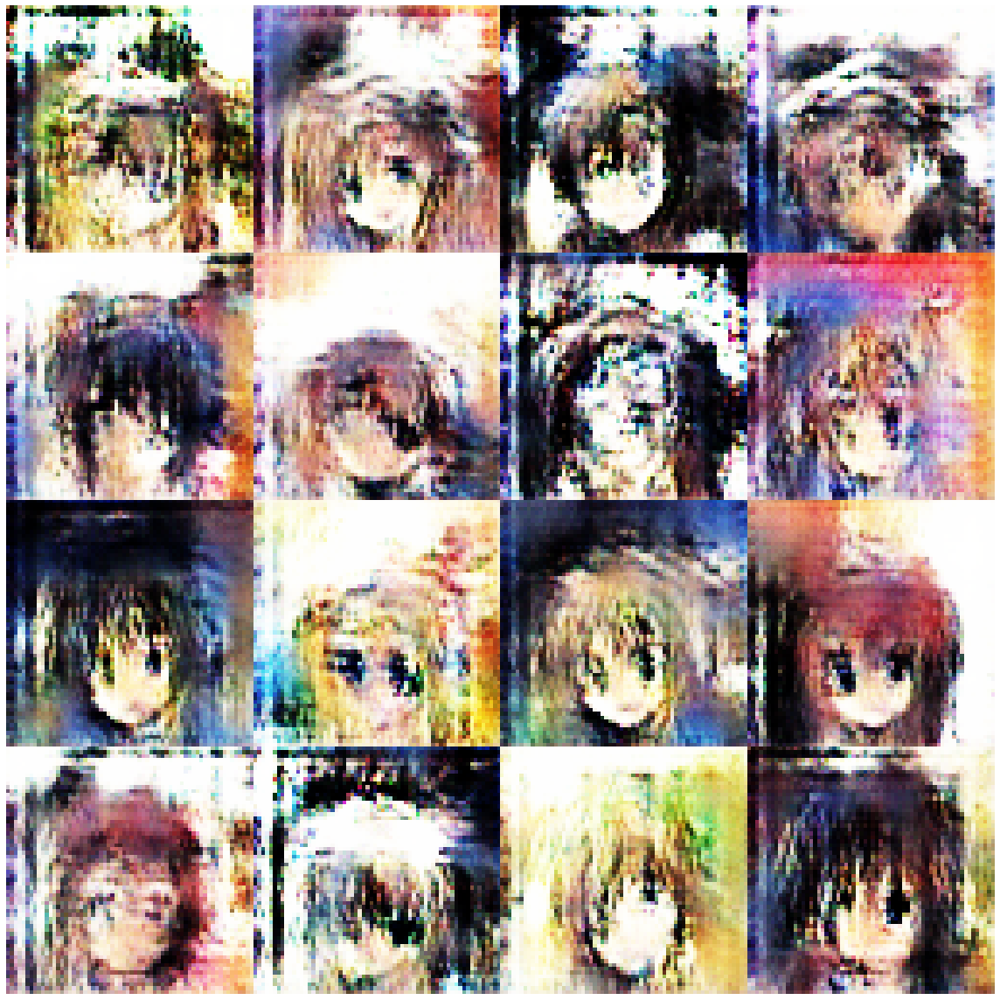

Begin step:  1500


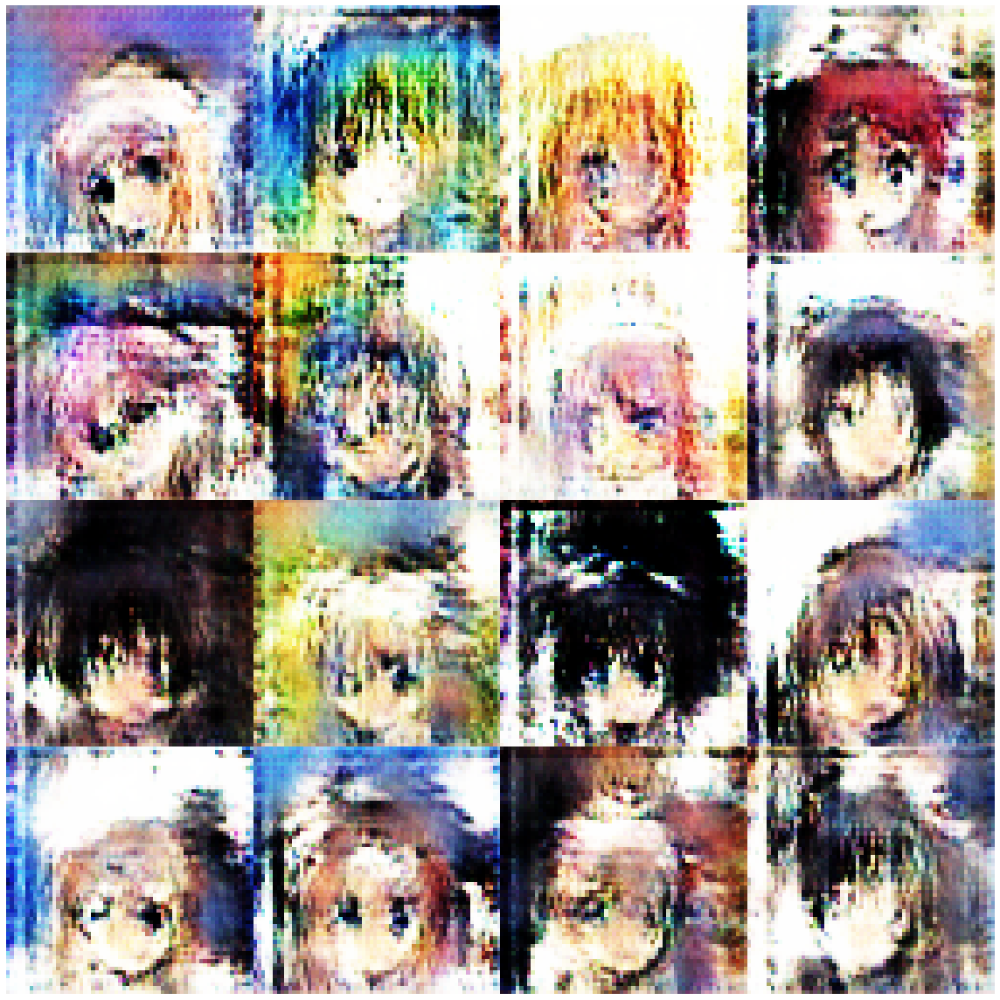

Disc: real loss: 0.738034 fake loss: 0.343966
GAN loss: 1.807446
Step 1500 completed. Time took: 1 secs.
Begin step:  1501
Disc: real loss: 0.362358 fake loss: 0.634819
GAN loss: 4.528212
Step 1501 completed. Time took: 0 secs.
Begin step:  1502
Disc: real loss: 0.718332 fake loss: 0.364420
GAN loss: 1.978057
Step 1502 completed. Time took: 0 secs.
Begin step:  1503
Disc: real loss: 0.371741 fake loss: 0.632324
GAN loss: 3.697752
Step 1503 completed. Time took: 0 secs.
Begin step:  1504
Disc: real loss: 0.448340 fake loss: 0.387511
GAN loss: 3.100833
Step 1504 completed. Time took: 0 secs.
Begin step:  1505
Disc: real loss: 0.405833 fake loss: 0.534309
GAN loss: 2.745157
Step 1505 completed. Time took: 0 secs.
Begin step:  1506
Disc: real loss: 0.386717 fake loss: 0.384773
GAN loss: 2.174931
Step 1506 completed. Time took: 0 secs.
Begin step:  1507
Disc: real loss: 0.348223 fake loss: 0.583405
GAN loss: 3.515734
Step 1507 completed. Time took: 0 secs.
Begin step:  1508
Disc: real loss:

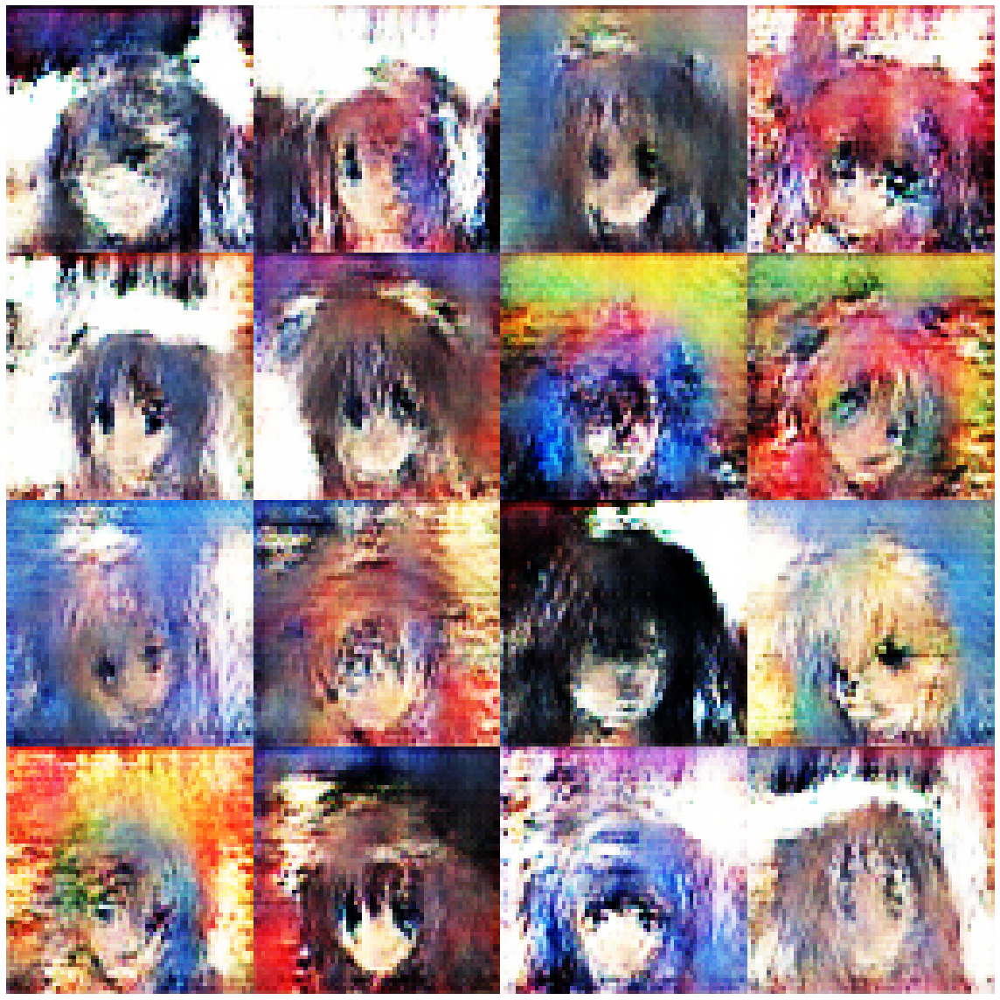

Disc: real loss: 0.528818 fake loss: 0.450318
GAN loss: 3.127536
Step 1600 completed. Time took: 1 secs.
Begin step:  1601
Disc: real loss: 0.361759 fake loss: 0.397062
GAN loss: 2.095837
Step 1601 completed. Time took: 0 secs.
Begin step:  1602
Disc: real loss: 0.361623 fake loss: 0.571217
GAN loss: 3.691057
Step 1602 completed. Time took: 0 secs.
Begin step:  1603
Disc: real loss: 0.565874 fake loss: 0.413116
GAN loss: 2.364186
Step 1603 completed. Time took: 0 secs.
Begin step:  1604
Disc: real loss: 0.378790 fake loss: 0.402301
GAN loss: 2.951910
Step 1604 completed. Time took: 0 secs.
Begin step:  1605
Disc: real loss: 0.399432 fake loss: 0.401704
GAN loss: 2.065335
Step 1605 completed. Time took: 0 secs.
Begin step:  1606
Disc: real loss: 0.340119 fake loss: 0.539727
GAN loss: 3.440492
Step 1606 completed. Time took: 0 secs.
Begin step:  1607
Disc: real loss: 0.540073 fake loss: 0.392044
GAN loss: 1.893112
Step 1607 completed. Time took: 0 secs.
Begin step:  1608
Disc: real loss:

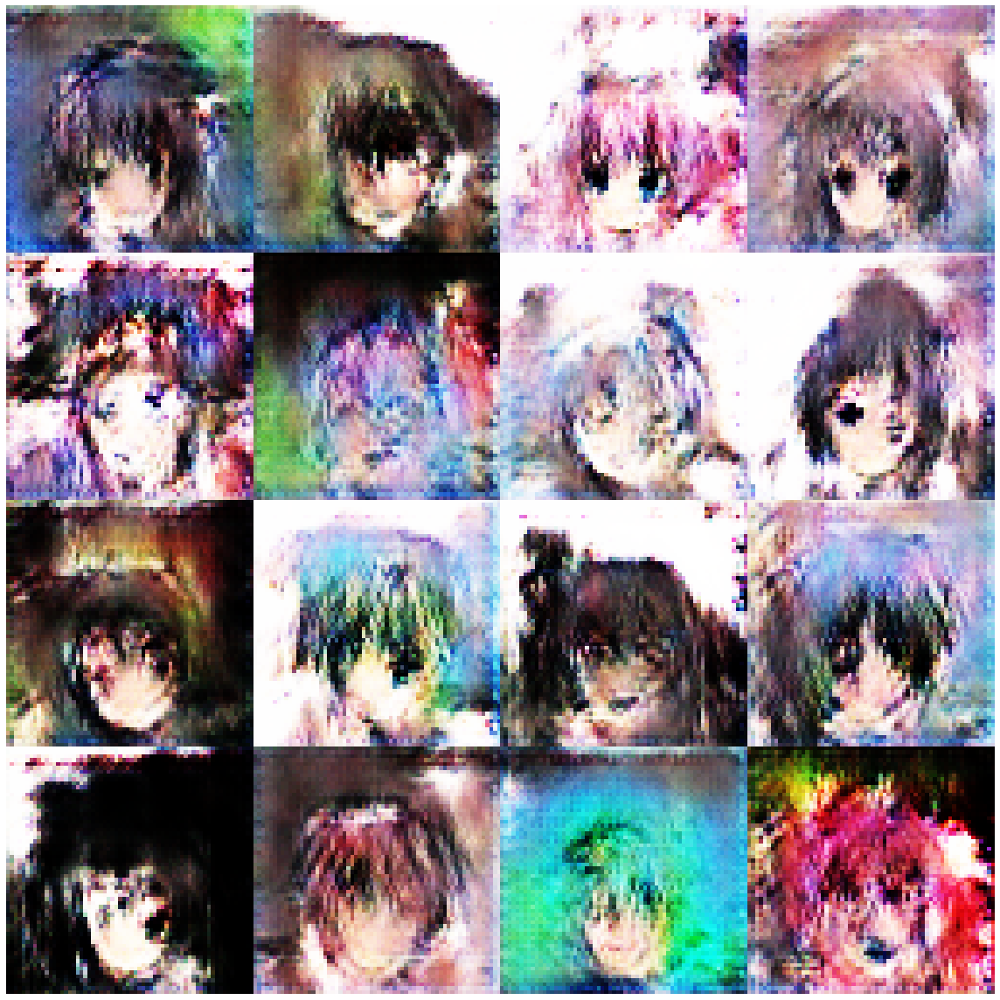

Disc: real loss: 0.343433 fake loss: 0.455656
GAN loss: 3.222404
Step 1700 completed. Time took: 1 secs.
Begin step:  1701
Disc: real loss: 0.386588 fake loss: 0.375491
GAN loss: 2.505880
Step 1701 completed. Time took: 0 secs.
Begin step:  1702
Disc: real loss: 0.377816 fake loss: 0.414424
GAN loss: 2.176145
Step 1702 completed. Time took: 0 secs.
Begin step:  1703
Disc: real loss: 0.405640 fake loss: 0.448949
GAN loss: 2.798031
Step 1703 completed. Time took: 0 secs.
Begin step:  1704
Disc: real loss: 0.486605 fake loss: 0.438371
GAN loss: 3.011221
Step 1704 completed. Time took: 0 secs.
Begin step:  1705
Disc: real loss: 0.428426 fake loss: 0.328551
GAN loss: 2.905190
Step 1705 completed. Time took: 0 secs.
Begin step:  1706
Disc: real loss: 0.380375 fake loss: 0.359873
GAN loss: 2.643328
Step 1706 completed. Time took: 0 secs.
Begin step:  1707
Disc: real loss: 0.377713 fake loss: 0.359708
GAN loss: 2.571194
Step 1707 completed. Time took: 0 secs.
Begin step:  1708
Disc: real loss:

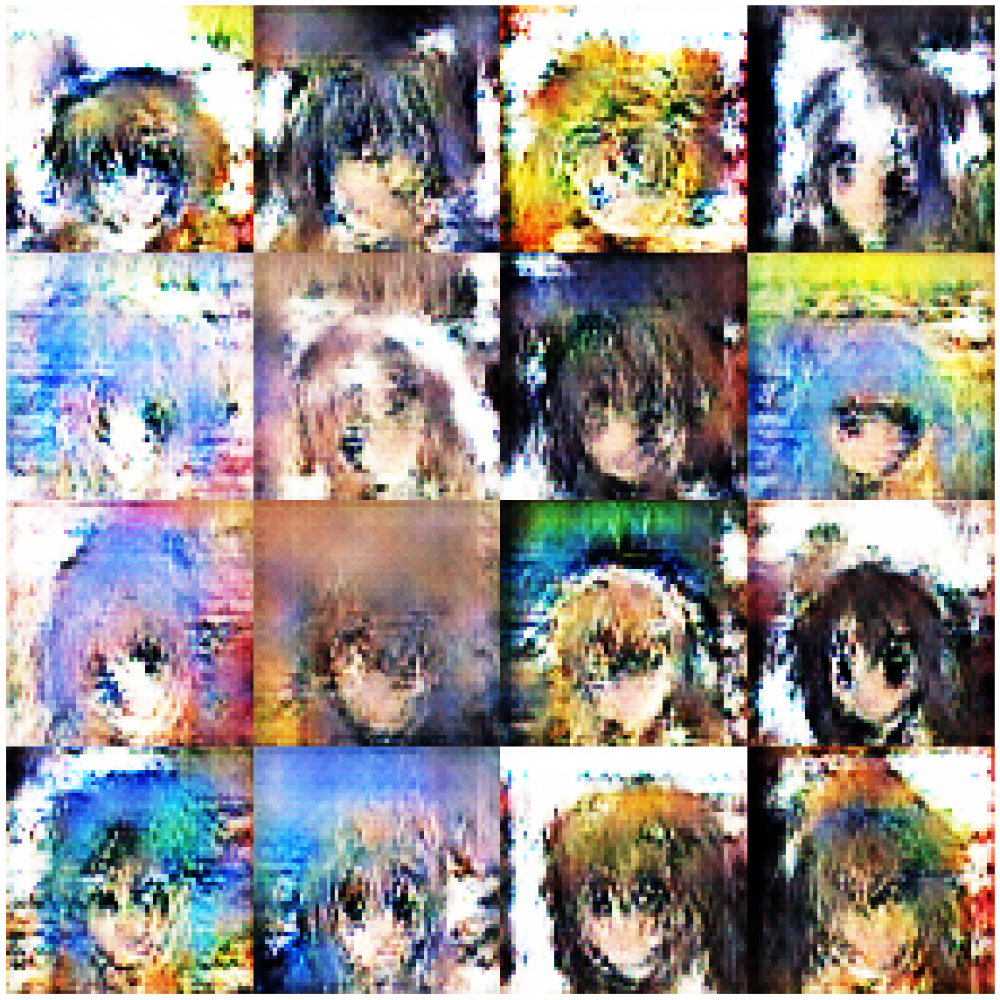

Disc: real loss: 0.362348 fake loss: 0.528179
GAN loss: 3.028238
Step 1800 completed. Time took: 1 secs.
Begin step:  1801
Disc: real loss: 0.421210 fake loss: 0.359735
GAN loss: 2.269098
Step 1801 completed. Time took: 0 secs.
Begin step:  1802
Disc: real loss: 0.408973 fake loss: 0.658873
GAN loss: 3.329095
Step 1802 completed. Time took: 0 secs.
Begin step:  1803
Disc: real loss: 0.531480 fake loss: 0.367531
GAN loss: 2.160756
Step 1803 completed. Time took: 0 secs.
Begin step:  1804
Disc: real loss: 0.327827 fake loss: 0.514892
GAN loss: 3.160239
Step 1804 completed. Time took: 0 secs.
Begin step:  1805
Disc: real loss: 0.412956 fake loss: 0.352472
GAN loss: 2.330628
Step 1805 completed. Time took: 0 secs.
Begin step:  1806
Disc: real loss: 0.394283 fake loss: 0.475572
GAN loss: 2.990099
Step 1806 completed. Time took: 0 secs.
Begin step:  1807
Disc: real loss: 0.426124 fake loss: 0.411469
GAN loss: 2.047164
Step 1807 completed. Time took: 0 secs.
Begin step:  1808
Disc: real loss:

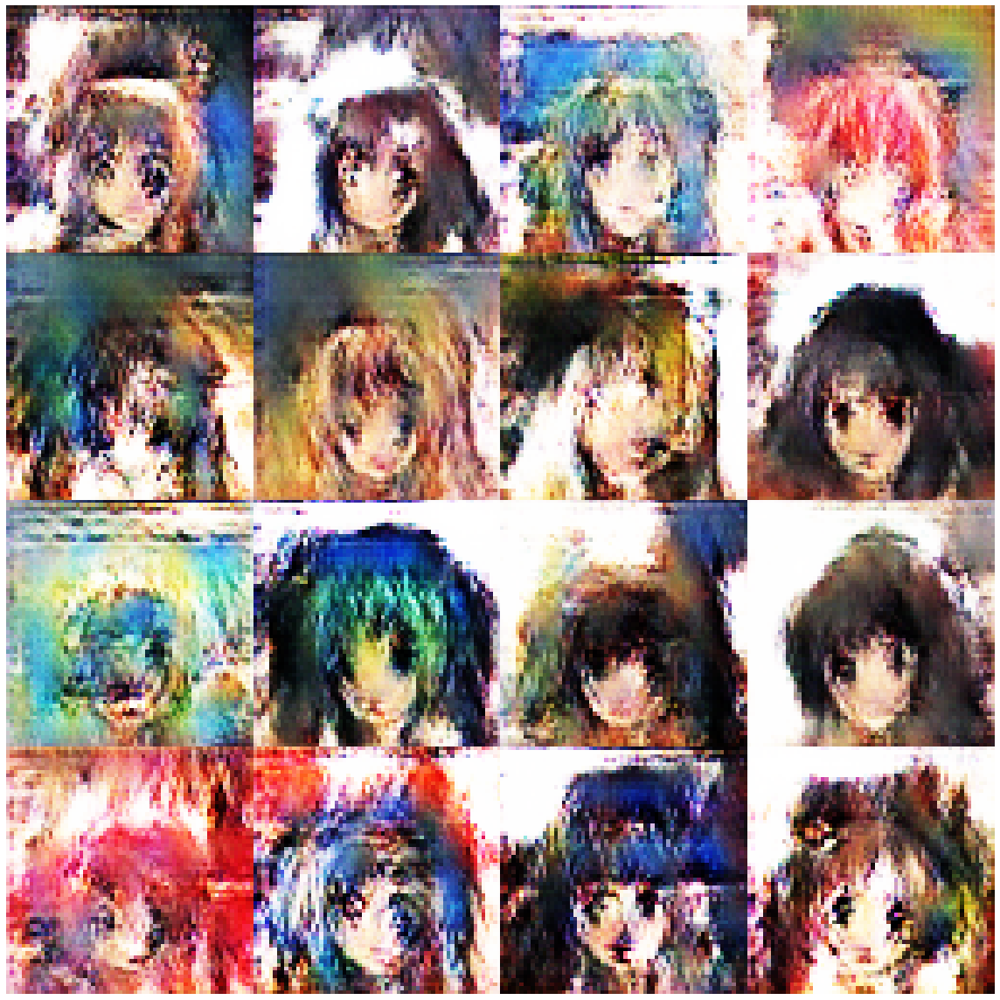

Disc: real loss: 1.228082 fake loss: 0.417971
GAN loss: 1.440270
Step 1900 completed. Time took: 1 secs.
Begin step:  1901
Disc: real loss: 0.356448 fake loss: 0.455278
GAN loss: 2.748909
Step 1901 completed. Time took: 0 secs.
Begin step:  1902
Disc: real loss: 0.387801 fake loss: 0.360159
GAN loss: 1.832252
Step 1902 completed. Time took: 0 secs.
Begin step:  1903
Disc: real loss: 0.373567 fake loss: 0.576213
GAN loss: 3.382473
Step 1903 completed. Time took: 0 secs.
Begin step:  1904
Disc: real loss: 0.589475 fake loss: 0.408513
GAN loss: 1.620243
Step 1904 completed. Time took: 0 secs.
Begin step:  1905
Disc: real loss: 0.345925 fake loss: 0.616288
GAN loss: 3.381964
Step 1905 completed. Time took: 0 secs.
Begin step:  1906
Disc: real loss: 0.616833 fake loss: 0.343809
GAN loss: 1.636554
Step 1906 completed. Time took: 0 secs.
Begin step:  1907
Disc: real loss: 0.365098 fake loss: 0.435319
GAN loss: 2.627890
Step 1907 completed. Time took: 0 secs.
Begin step:  1908
Disc: real loss:

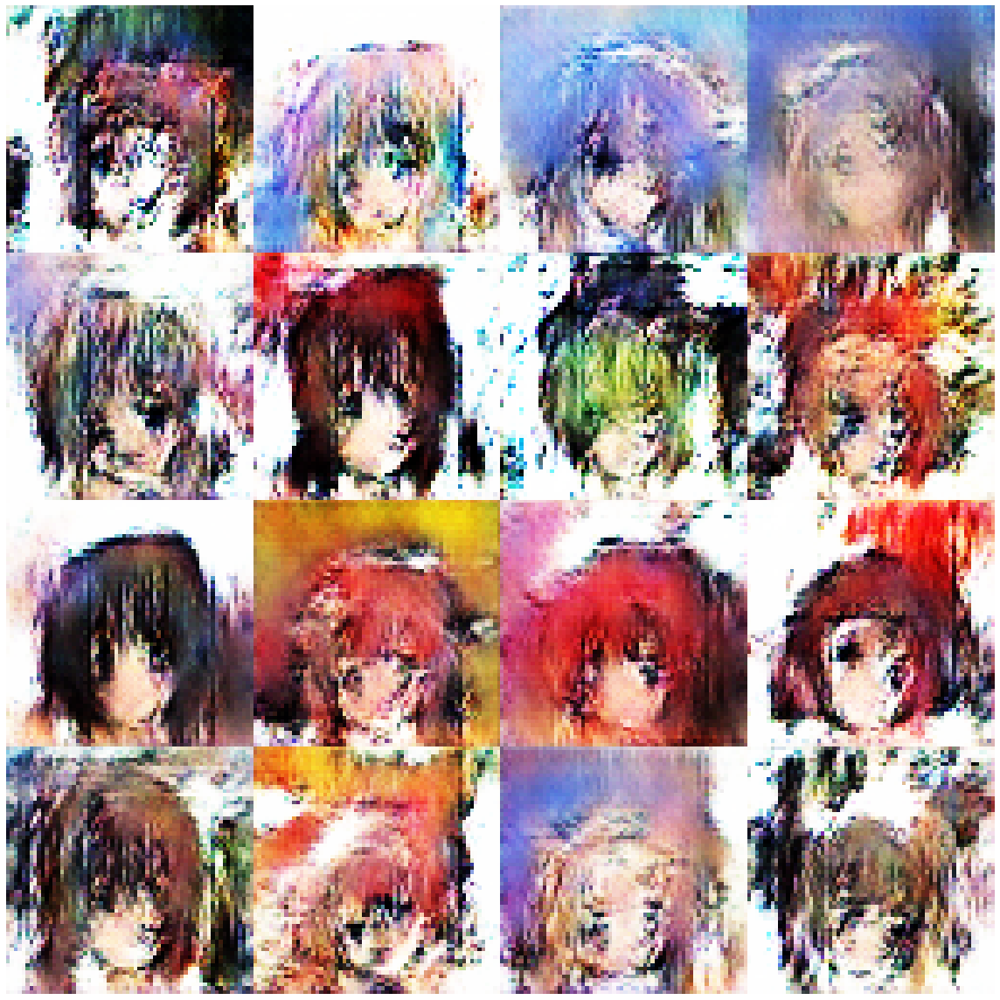

In [21]:
# Use a fixed noise vector to see how the GAN Images transition through time on a fixed noise. 
fixed_noise = gen_noise(16,noise_shape)

# To keep Track of losses
avg_disc_fake_loss = []
avg_disc_real_loss = []
avg_GAN_loss = []

# We will run for num_steps iterations
for step in range(num_steps): 
    tot_step = step
    print("Begin step: ", tot_step)
    # to keep track of time per step
    step_begin_time = time.time() 
    
    # sample a batch of normalized images from the dataset
    real_data_X = sample_from_dataset(batch_size, image_shape, data_dir=data_dir)
    
    # Genearate noise to send as input to the generator
    noise = gen_noise(batch_size,noise_shape)
    
    # Use generator to create(predict) images
    fake_data_X = generator.predict(noise)
    
    # Save predicted images from the generator every 10th step
    if (tot_step % 100) == 0:
        step_num = str(tot_step).zfill(4)
        save_img_batch(fake_data_X,img_save_dir+step_num+"_image.png")
    
    # Create the labels for real and fake data. We don't give exact ones and zeros but add a small amount of noise. This is an important GAN training trick
    real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
    fake_data_Y = np.random.random_sample(batch_size)*0.2
        
    # train the discriminator using data and labels

    discriminator.trainable = True
    generator.trainable = False

    # Training Discriminator seperately on real data
    dis_metrics_real = discriminator.train_on_batch(real_data_X,real_data_Y) 
    # training Discriminator seperately on fake data
    dis_metrics_fake = discriminator.train_on_batch(fake_data_X,fake_data_Y) 
    
    print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))
    
    # Save the losses to plot later
    avg_disc_fake_loss.append(dis_metrics_fake[0])
    avg_disc_real_loss.append(dis_metrics_real[0])
    
    # Train the generator using a random vector of noise and its labels (1's with noise)
    generator.trainable = True
    discriminator.trainable = False

    GAN_X = gen_noise(batch_size,noise_shape)
    GAN_Y = real_data_Y
   
    gan_metrics = gan.train_on_batch(GAN_X,GAN_Y)
    print("GAN loss: %f" % (gan_metrics[0]))
    
    # Log results by opening a file in append mode
    text_file = open(log_dir+"\\training_log.txt", "a")
    text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0], dis_metrics_fake[0],gan_metrics[0]))
    text_file.close()

    # save GAN loss to plot later
    avg_GAN_loss.append(gan_metrics[0])
            
    end_time = time.time()
    diff_time = int(end_time - step_begin_time)
    print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))
    
    # save model at every 500 steps
    if ((tot_step+1) % 500) == 0:
        print("-----------------------------------------------------------------")
        print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss))) 
        print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss))) 
        print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
        print("-----------------------------------------------------------------")
        discriminator.trainable = False
        generator.trainable = False
        # predict on fixed_noise
        fixed_noise_generate = generator.predict(noise)
        step_num = str(tot_step).zfill(4)
        save_img_batch(fixed_noise_generate,img_save_dir+step_num+"fixed_image.png")
        generator.save(save_model_dir+str(tot_step)+"_GENERATOR_weights_and_arch.hdf5")
        discriminator.save(save_model_dir+str(tot_step)+"_DISCRIMINATOR_weights_and_arch.hdf5")

# Results

## 1. Generate Images

Displaying generated images


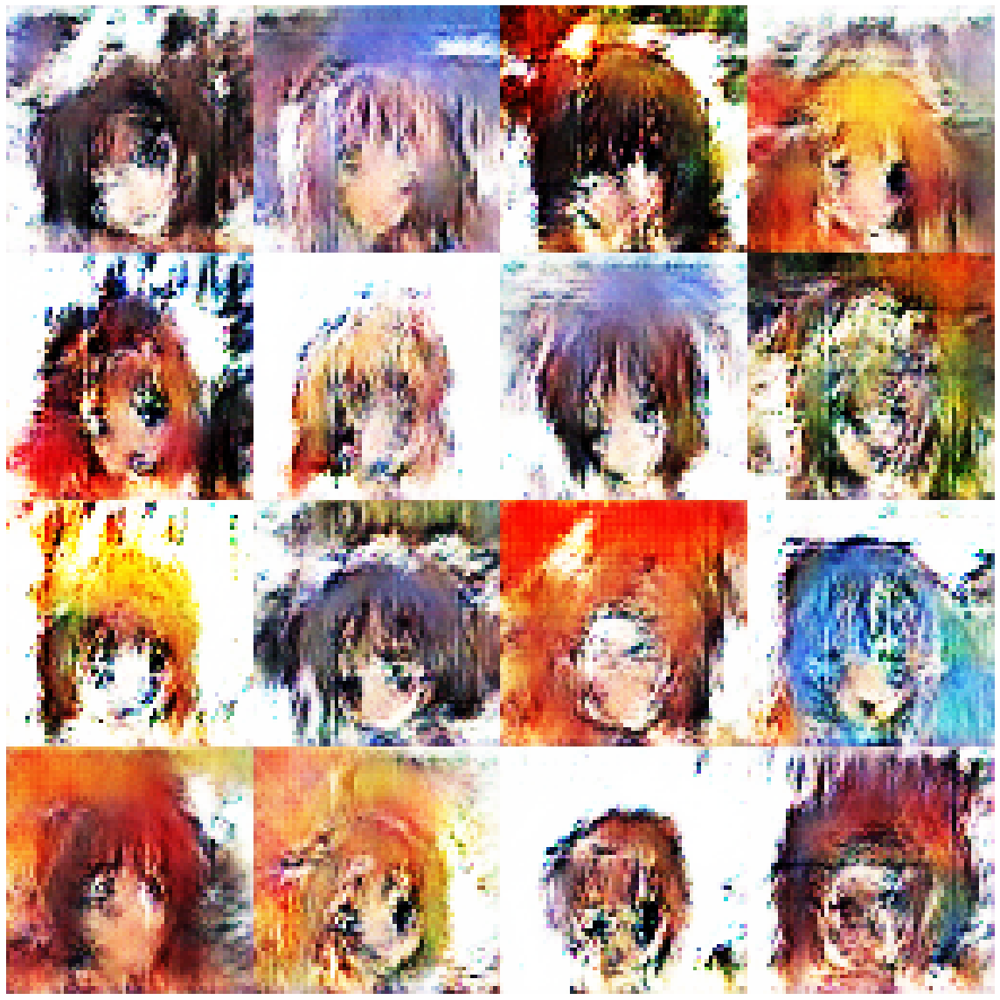

In [27]:
def generate_images(generator, save_dir):
    noise = gen_noise(batch_size,noise_shape)
    fake_data_X = generator.predict(noise)
    print("Displaying generated images")
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(fake_data_X.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = fake_data_X[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(save_dir+str(time.time())+"_GENERATEDimage.png",bbox_inches='tight',pad_inches=0)
    plt.show()

generate_images(generator, img_save_dir)

## 2. Loss graph

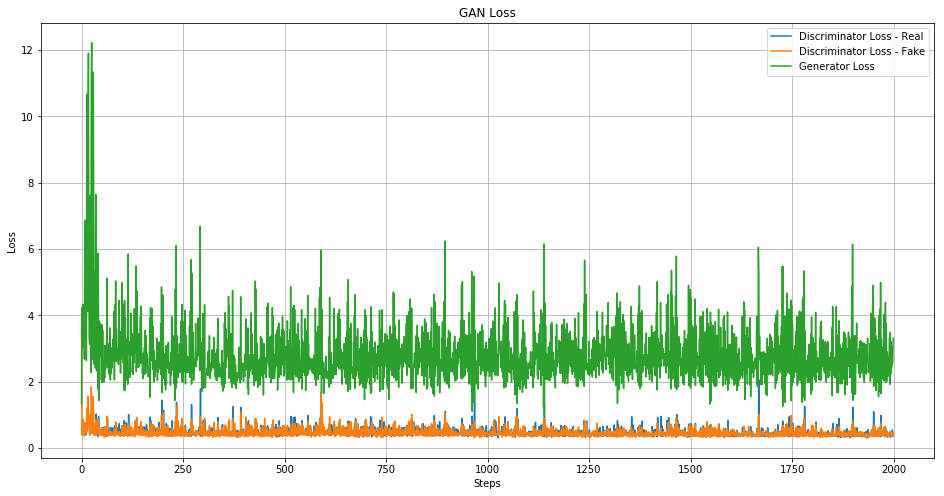

In [28]:
disc_real_loss = np.array(avg_disc_real_loss)
disc_fake_loss = np.array(avg_disc_fake_loss)
GAN_loss = np.array(avg_GAN_loss)

# Plot the losses vs training steps
plt.figure(figsize=(16,8))
plt.plot(range(0,num_steps), disc_real_loss, label="Discriminator Loss - Real")
plt.plot(range(0,num_steps), disc_fake_loss, label="Discriminator Loss - Fake")
plt.plot(range(0,num_steps), GAN_loss, label="Generator Loss")
plt.xlabel('Steps')
plt.ylabel('Loss')
plt.legend()
plt.title('GAN Loss')
plt.grid(True)
plt.show() 

## 3. Create GIF for training

In [0]:
#Generating GIF from PNGs
import imageio
# create a list of PNGs
generated_images = [img_save_dir+str(x).zfill(4)+"_image.png" for x in range(0,num_steps,100)]

In [0]:
images = []
for filename in generated_images:
    images.append(imageio.imread(filename))

imageio.mimsave(img_save_dir+'movie.gif', images) 

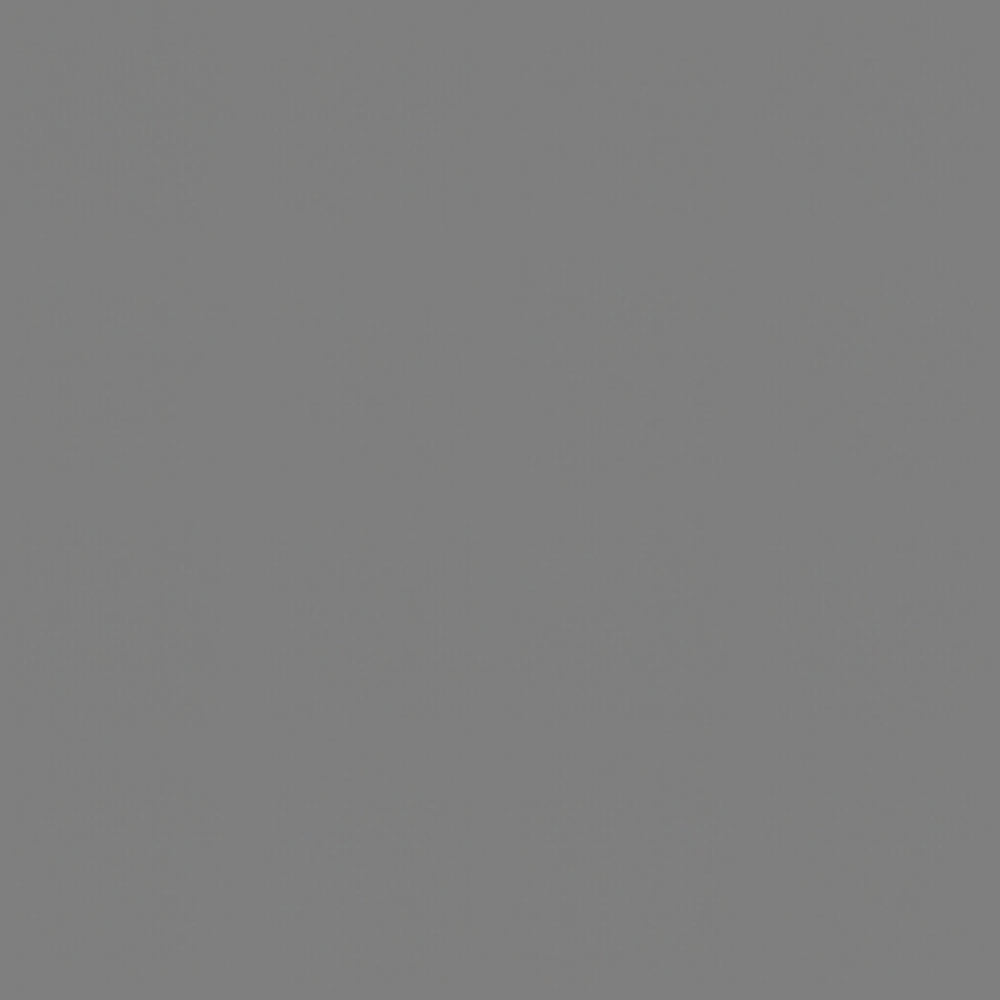

In [31]:
from IPython.display import Image
with open("images/movie.gif",'rb') as f:
    display(Image(data=f.read(), format='png'))

# Summary

In this Project, we learned about the structure of GANs, Discriminators, Generators and how to train a GAN to generate images. This model is not very good at generating fake images, yet we get to understand the basics of GANs with this project and we are fired up to build more interesting and complex projects as we go forward.